# Tutorial 2: Basic programing for image processing

Before we start, let's download the image we will be using for this tutorial. We will download it directly from a GitHub repository.

In [122]:
!mkdir -p Images
!git clone https://github.com/prarinya-lab/TSH61500-tutorials.git
!mv TSH61500-tutorials/tutorial_1/Images/* Images/
!rm -rf TSH61500-tutorials

Cloning into 'TSH61500-tutorials'...
remote: Enumerating objects: 52, done.
remote: Counting objects: 100% (52/52), done.
remote: Compressing objects: 100% (46/46), done.
remote: Total 52 (delta 5), reused 49 (delta 5), pack-reused 0 (from 0)
Receiving objects: 100% (52/52), 32.77 MiB | 36.68 MiB/s, done.
Resolving deltas: 100% (5/5), done.


## 1. Read/Show/Write an Image

This tutorial provides an introduction to basic image processing techniques using the OpenCV library. You will learn how to perform fundamental operations such as reading, writing, and displaying images, accessing and manipulating pixel values, resizing images, and working with color channels.

OpenCV (Open Source Computer Vision Library) is a powerful library used for a wide range of image and video processing tasks. It provides a comprehensive set of tools and functions for operations such as reading, writing, and displaying images, manipulating pixels, color space conversions, and various image transformations. It's widely used in computer vision applications, including object detection, facial recognition, and image analysis.

### 1.1. Read and Write Image
For typical Python code, you may write the code on the .py file like this:

```
import cv2
import sys

img = cv2.imread("Images/capybara.png")

if img is None:
    sys.exit("Could not read the image.")

cv2.imshow("Display window", img)
k = cv2.waitKey(0)

if k == ord("s"):
    cv2.imwrite("Results/t1-1.jpg", img)
    
cv2.destroyAllWindows()
```



In [ ]:
import cv2
import sys

img = cv2.imread("Images/lenna.png")

if img is None:
    sys.exit("Could not read the image.")

### 1.2. Show Color Image by matplotlib

For Jupyter Notebook code, we cannot use the HighGUI in OpenCV. So, we have to use other python library (such as matplotlib) for showing an image instead

Let try!

In [ ]:
# cv2.imshow() is not suitable for notebook style programing.
# Instead, we use matplotlib to show image on jupyter notebook

import matplotlib.pyplot as plt

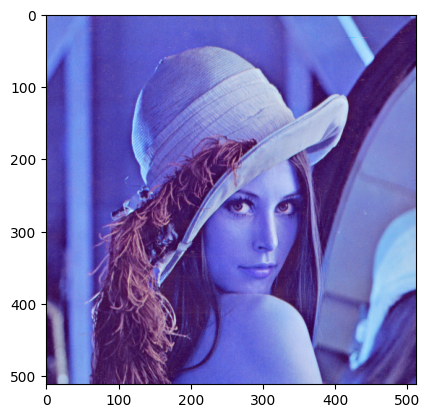

In [ ]:
# display the image
plt.imshow(img)
plt.show()

Oh! We got a problem. The color looks very weird

Let try this:

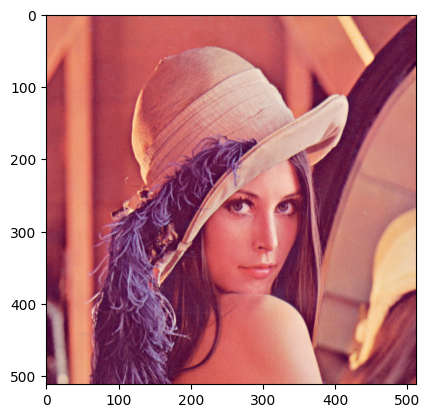

In [ ]:
# display the image
img_plt = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Convert BGR to RGB order
plt.imshow(img_plt)
plt.show()

As you can see, there's a color difference in the displayed image. This is because OpenCV uses BGR order for color channels, while Matplotlib uses RGB order. To display the image correctly with Matplotlib, we need to convert from BGR to RGB.

### 1.3. Grayscale Conversion

### 1.4. Show Grayscale Image by matplotlib

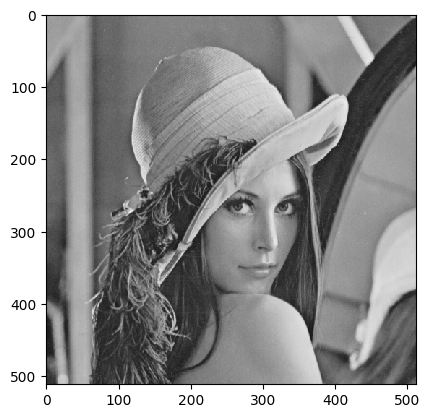

In [ ]:
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

## 2. Image Properties

### 2.1. Seeing inside Matrix


In [ ]:
print(img)

[[[125 137 226]
  [125 137 226]
  [133 137 223]
  ...
  [122 148 230]
  [110 130 221]
  [ 90  99 200]]

 [[125 137 226]
  [125 137 226]
  [133 137 223]
  ...
  [122 148 230]
  [110 130 221]
  [ 90  99 200]]

 [[125 137 226]
  [125 137 226]
  [133 137 223]
  ...
  [122 148 230]
  [110 130 221]
  [ 90  99 200]]

 ...

 [[ 60  18  84]
  [ 60  18  84]
  [ 58  27  92]
  ...
  [ 84  73 173]
  [ 76  68 172]
  [ 79  62 177]]

 [[ 57  22  82]
  [ 57  22  82]
  [ 62  32  96]
  ...
  [ 79  70 179]
  [ 81  71 181]
  [ 81  74 185]]

 [[ 57  22  82]
  [ 57  22  82]
  [ 62  32  96]
  ...
  [ 79  70 179]
  [ 81  71 181]
  [ 81  74 185]]]


### 2.2. Image Type

In [ ]:
print(type(img))

<class 'numpy.ndarray'>


### 2.3. Image Size #1

In [ ]:
print(img.shape)

(512, 512, 3)


### 2.4. Image Size #2

In [ ]:
nrows = img.shape[0]
ncols = img.shape[1]
nchannels = img.shape[2]

print(nrows)
print(ncols)
print(nchannels)

512
512
3


## 3. Resize Image

In [ ]:
# 3.1. Image size #1
resized_img1 = cv2.resize(img, None, fx= 0.5, fy=0.5, interpolation= cv2.INTER_LINEAR)

In [ ]:
# 3.2. Image size #2
new_rows = 300
new_cols = 300
dim = (new_cols, new_rows)
resized_img2 = cv2.resize(img, dim, interpolation= cv2.INTER_LINEAR)

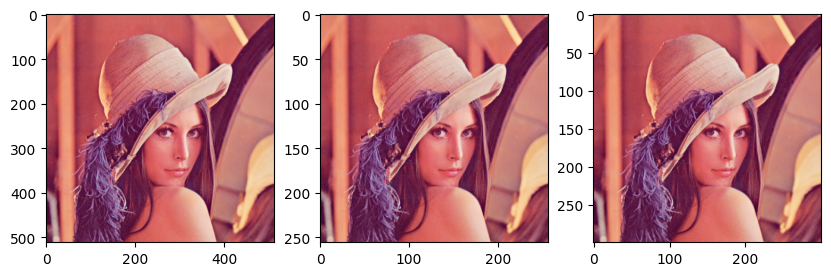

In [ ]:
# 3.3. Show Image on suplots
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 10))
ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax2.imshow(cv2.cvtColor(resized_img1, cv2.COLOR_BGR2RGB))
ax3.imshow(cv2.cvtColor(resized_img2, cv2.COLOR_BGR2RGB))
plt.show()

In [ ]:
print(img.shape)
print(resized_img1.shape)
print(resized_img2.shape)

(512, 512, 3)
(256, 256, 3)
(300, 300, 3)


## 4. Copy an image (Cloning)

In [ ]:
## WARNING !!!!
# DO NOT USE:
#      img_clone = img
# It will point 'img' to 'img_clone'
img_clone = img.copy()

## 5. Accessing Pixels

In [ ]:
# 5.1. Accessing a pixel #1
px = img[100,100]
print(px)

[ 78  68 178]


In [ ]:
# 5.2. Accessing a pixel #2
px_blue = img[100,100, 0]
print(px_blue)

78


## 6. Image Region Of Interest (ROI)

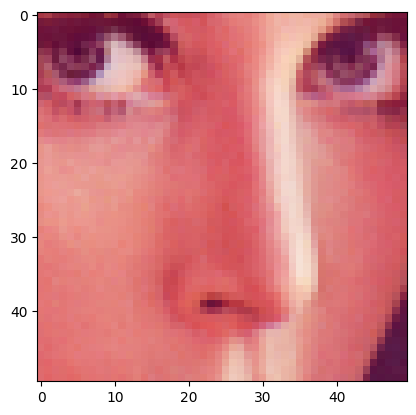

In [ ]:
# 6. Image ROI
roi = resized_img2[150:200, 150:200]
roi.shape

# display the image
plt.imshow(cv2.cvtColor(roi, cv2.COLOR_BGR2RGB))
plt.show()

## 7. Editing Pixels

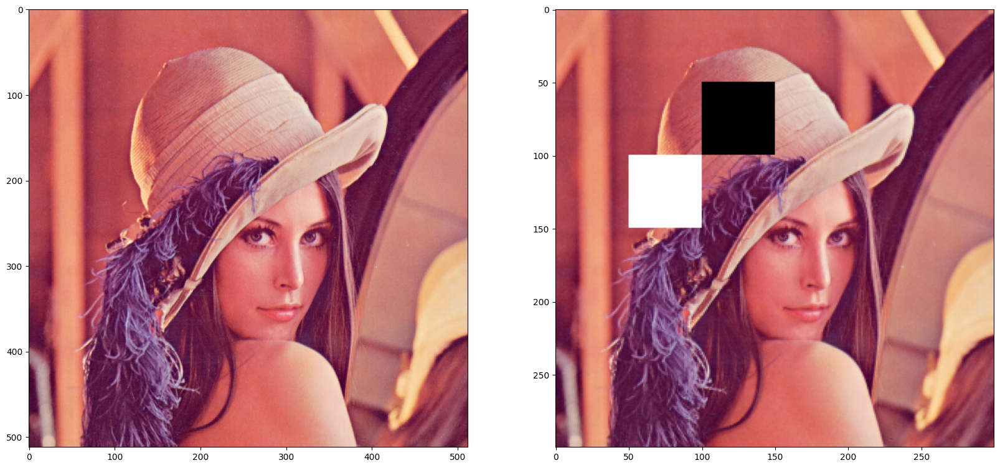

In [ ]:
# 7. Editing Pixels
img_edited = resized_img2.copy()     ## Again, be careful when you copy an image/matrix in OpenCV

#Edit pixel from range
img_edited[50:100, 100:150] = [0,0,0]
img_edited[100:150, 50:100] = 255

# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax2.imshow(cv2.cvtColor(img_edited, cv2.COLOR_BGR2RGB))
plt.show()

## 8. Split & Merge Channels

In [ ]:
# 8.1. Split Channels #1
img_b,img_g,img_r = cv2.split(img)

(512, 512, 3)
(512, 512)
(512, 512)
(512, 512)


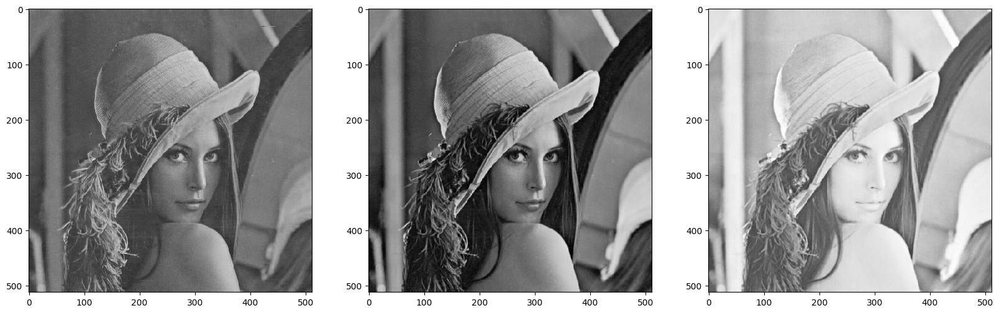

In [ ]:
# 8.3. Check Outputs
print(img.shape)
print(img_b.shape)
print(img_g.shape)
print(img_r.shape)

# display the images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(img_b, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(img_g, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax3.imshow(img_r, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

Alternatively, you can also try to split matrix by:

In [ ]:
# 8.2. Split Channels #2
img_b = img[:,:,0].copy()
img_g = img[:,:,1].copy()
img_r = img[:,:,2].copy()

print(img.shape)
print(img_b.shape)
print(img_g.shape)
print(img_r.shape)

(512, 512, 3)
(512, 512)
(512, 512)
(512, 512)


We can show the intensity of each color channel as grayscale images as follow:

(512, 512, 3)
(512, 512)
(512, 512)
(512, 512)


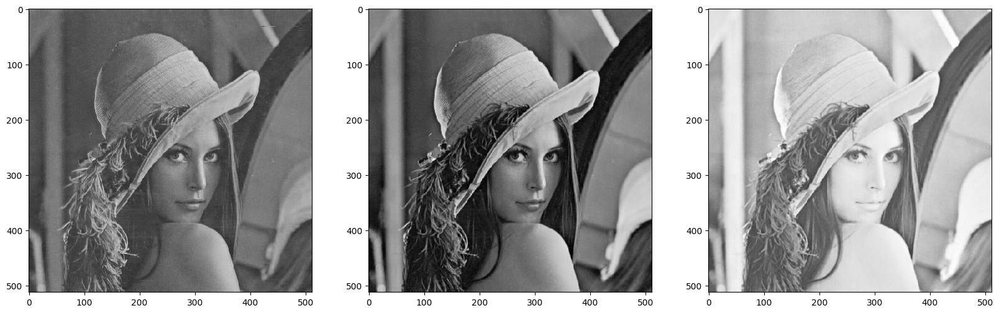

In [ ]:
# 8.3. Check Outputs
print(img.shape)
print(img_b.shape)
print(img_g.shape)
print(img_r.shape)

# display the images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(img_b, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(img_g, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax3.imshow(img_r, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

Let try to edit every pixel of *green channel* to be all zeros

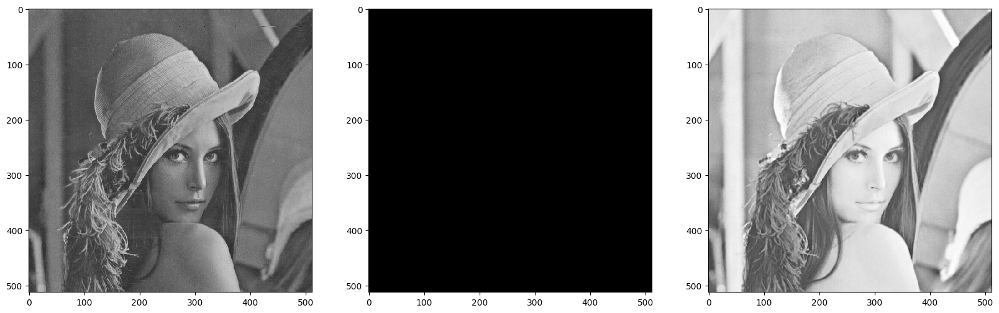

In [ ]:
# Try to edit every pixel to be zero !
img_g[:,:] = 0

# display the images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(img_b, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(img_g, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax3.imshow(img_r, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

Then, merge all color channels back to a single BGR color image.

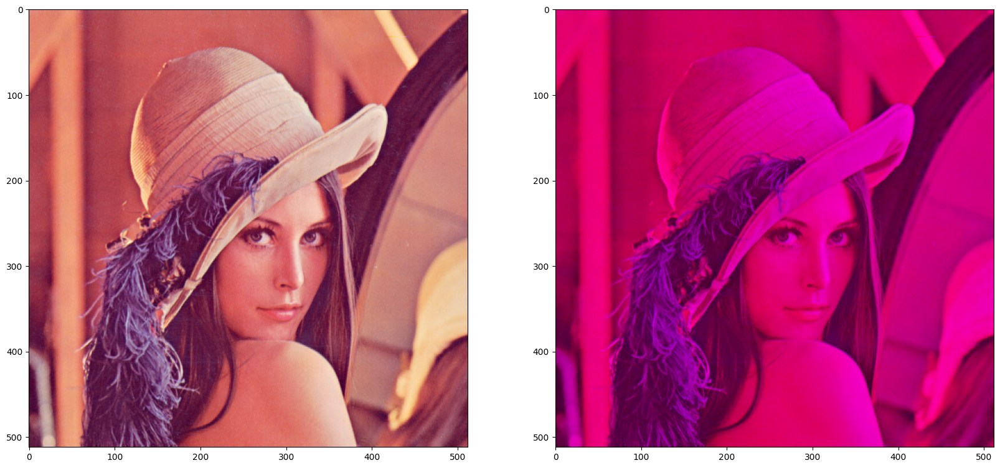

In [ ]:
# 8.4. Merge Channels
img_merged = cv2.merge([img_b,img_g, img_r])

# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax2.imshow(cv2.cvtColor(img_merged, cv2.COLOR_BGR2RGB))
plt.show()


By using this technique, we can also visualize the intensity level of each color channel by setting the other channels to zero.

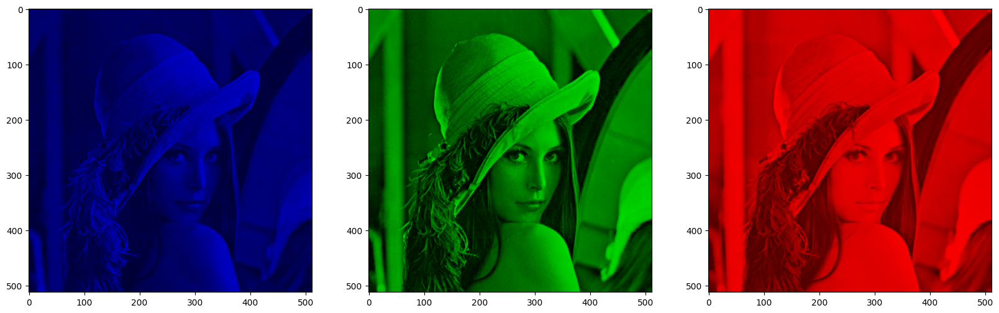

In [ ]:
# Show each RGB channel as color
img_rgb_b = img.copy()
img_rgb_g = img.copy()
img_rgb_r = img.copy()

# show only blue
img_rgb_b[:,:,1] = 0 #remove green
img_rgb_b[:,:,2] = 0 #remove red

# show only green
img_rgb_g[:,:,0] = 0 #remove blue
img_rgb_g[:,:,2] = 0 #remove red

# show only red
img_rgb_r[:,:,0] = 0 #remove blue
img_rgb_r[:,:,1] = 0 #remove green

# display the images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(cv2.cvtColor(img_rgb_b, cv2.COLOR_BGR2RGB))
ax2.imshow(cv2.cvtColor(img_rgb_g, cv2.COLOR_BGR2RGB))
ax3.imshow(cv2.cvtColor(img_rgb_r, cv2.COLOR_BGR2RGB))
plt.show()

## 9. Color Conversion

Color conversion is a fundamental operation in image processing that involves transforming an image from one color space to another. Different color spaces represent colors in different ways, and converting between them can be useful for various tasks, such as isolating specific color information, improving the efficiency of certain algorithms, or preparing images for display on different devices. OpenCV provides functions to convert between various color spaces, including BGR, Grayscale, HSV (Hue, Saturation, Value), and CIE-LAB (Lightness, a*, b*). Each color space has its own advantages depending on the specific application.

### 9.1. BGR -> HSV

#### HSV (Hue, Saturation, Value) Color Space

The **HSV** color space is an alternative representation of color compared to **RGB** (or **BGR**).  
It separates color information from brightness, making it useful for computer vision tasks such as color-based object tracking and segmentation.

#### Components

- **Hue (H):** Represents the dominant color (e.g., red, green, blue).  
  Usually expressed as an angle from **0° to 360°** (OpenCV scales it to **0–179** for 8-bit images).

- **Saturation (S):** Represents the purity or intensity of the color.  
  - **0** → shade of gray  
  - **1 (or 255)** → fully saturated color  

- **Value (V):** Represents brightness.  
  - **0** → black  
  - **1 (or 255)** → brightest color  


#### Conversion Method (BGR → HSV)

Before conversion, normalize B, G, R to [0, 1]:

$$
B, G, R \in [0,1]
$$

Then find the maximum and minimum channel values:

$$
M = \max(R, G, B), \quad m = \min(R, G, B), \quad \Delta = M - m
$$

**Value:**
$$
V = M
$$

**Saturation:**
$$
S =
\begin{cases}
0, & M = 0 \\
\dfrac{\Delta}{M}, & \text{otherwise}
\end{cases}
$$

**Hue:**
$$
H =
\begin{cases}
60 \times \dfrac{G - B}{\Delta}, & M = R \\[6pt]
60 \times \left( \dfrac{B - R}{\Delta} + 2 \right), & M = G \\[6pt]
60 \times \left( \dfrac{R - G}{\Delta} + 4 \right), & M = B \\[6pt]
0, & M = m
\end{cases}
$$

Finally, wrap Hue into the range [0, 360):
$$
H = (H + 360) \bmod 360
$$

In OpenCV, for 8-bit images:

- **H:** 0–179  
- **S, V:** 0–255  


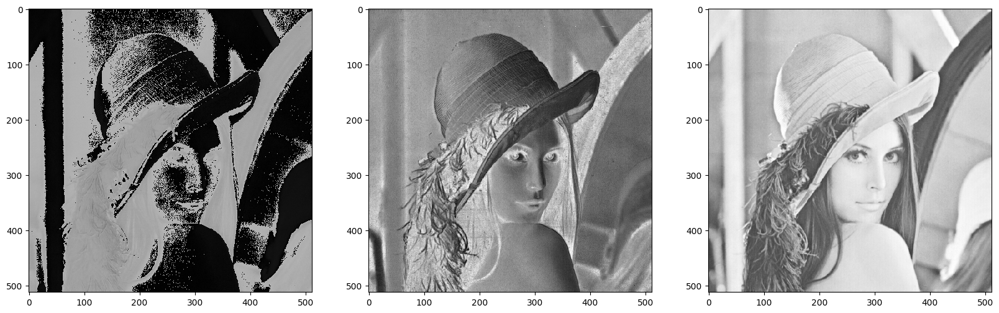

In [ ]:
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

img_h = img_hsv[:,:,0].copy() #Hue
img_s = img_hsv[:,:,1].copy() #Saturation
img_v = img_hsv[:,:,2].copy() #Value

# display the images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(img_h, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(img_s, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax3.imshow(img_v, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

### 9.2. BGR -> Lab

#### CIE L* a* b* (Lab) Color Space

The **CIE 1976 L\*a\*b\*** (or **CIE Lab**) color space is designed to be *perceptually uniform* — equal changes in numeric values correspond to roughly equal perceived color differences.  
It is **device-independent** and widely used in color management, printing, and computer vision.

#### Components

- **L\* (Lightness):** Brightness of the color  
  • Range: 0 (black) – 100 (white)  
  • In OpenCV 8-bit: 0 – 255  

- **a\*:** Position on the green (−) ↔ red (+) axis  
  • In OpenCV 8-bit: 0 – 255 (128 = neutral gray)

- **b\*:** Position on the blue (−) ↔ yellow (+) axis  
  • In OpenCV 8-bit: 0 – 255 (128 = neutral gray)

#### Conversion Method (BGR → Lab)

1. **Convert BGR → RGB**  
   OpenCV stores color channels in BGR order.

2. **Normalize RGB** to \[0, 1\]  

   $$
   R_n = \frac{R}{255},\quad
   G_n = \frac{G}{255},\quad
   B_n = \frac{B}{255}
   $$

3. **Convert sRGB → Linear RGB** (remove gamma correction)

   $$
   C_{lin} =
   \begin{cases}
   \dfrac{C_n}{12.92}, & C_n \le 0.04045\\[6pt]
   \left(\dfrac{C_n+0.055}{1.055}\right)^{2.4}, & C_n>0.04045
   \end{cases}
   $$
   where \(C_n\in\{R_n,G_n,B_n\}\).

4. **Linear RGB → CIE XYZ** (using sRGB matrix, D65 white point)

   $$
   \begin{bmatrix}
   X\\[3pt]Y\\[3pt]Z
   \end{bmatrix}
   =
   \begin{bmatrix}
   0.4124564 & 0.3575761 & 0.1804375\\[3pt]
   0.2126729 & 0.7151522 & 0.0721750\\[3pt]
   0.0193339 & 0.1191920 & 0.9503041
   \end{bmatrix}
   \!
   \begin{bmatrix}
   R_{lin}\\[3pt]G_{lin}\\[3pt]B_{lin}
   \end{bmatrix}
   $$

5. **Normalize XYZ** by the reference white point (D65):

   $$
   X_n=95.047,\;
   Y_n=100.000,\;
   Z_n=108.883
   $$

   $$
   x=\frac{X}{X_n},\quad
   y=\frac{Y}{Y_n},\quad
   z=\frac{Z}{Z_n}
   $$

6. **Convert CIE XYZ → CIE L\*a\*b\***

   Define

   $$
   f(t)=
   \begin{cases}
   t^{1/3}, & t > \delta^3\\[4pt]
   \dfrac{t}{3\delta^2}+\dfrac{4}{29}, & t \le \delta^3
   \end{cases},
   \qquad \delta=\tfrac{6}{29}
   $$

   Then compute:

   $$
   \begin{aligned}
   L^* &= 116\,f(y) - 16,\\[4pt]
   a^* &= 500\,[f(x)-f(y)],\\[4pt]
   b^* &= 200\,[f(y)-f(z)].
   \end{aligned}
   $$


OpenCV performs all these steps internally when you call:

```python
img_lab = cv2.cvtColor(img, cv2.COLOR_BGR2Lab)

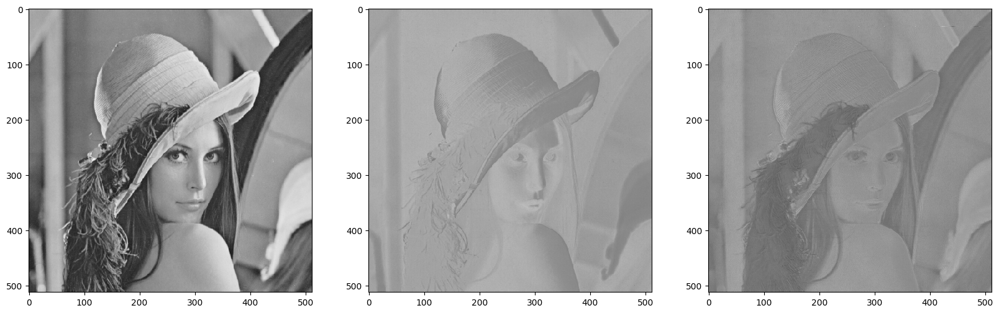

In [ ]:
img_lab = cv2.cvtColor(img, cv2.COLOR_BGR2Lab)

img_l = img_lab[:,:,0].copy() #lumination
img_a = img_lab[:,:,1].copy()
img_b = img_lab[:,:,2].copy()

# display the images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(img_l, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(img_a, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax3.imshow(img_b, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

## 10. Visualization

### 10.1. Histogram of a grayscale image

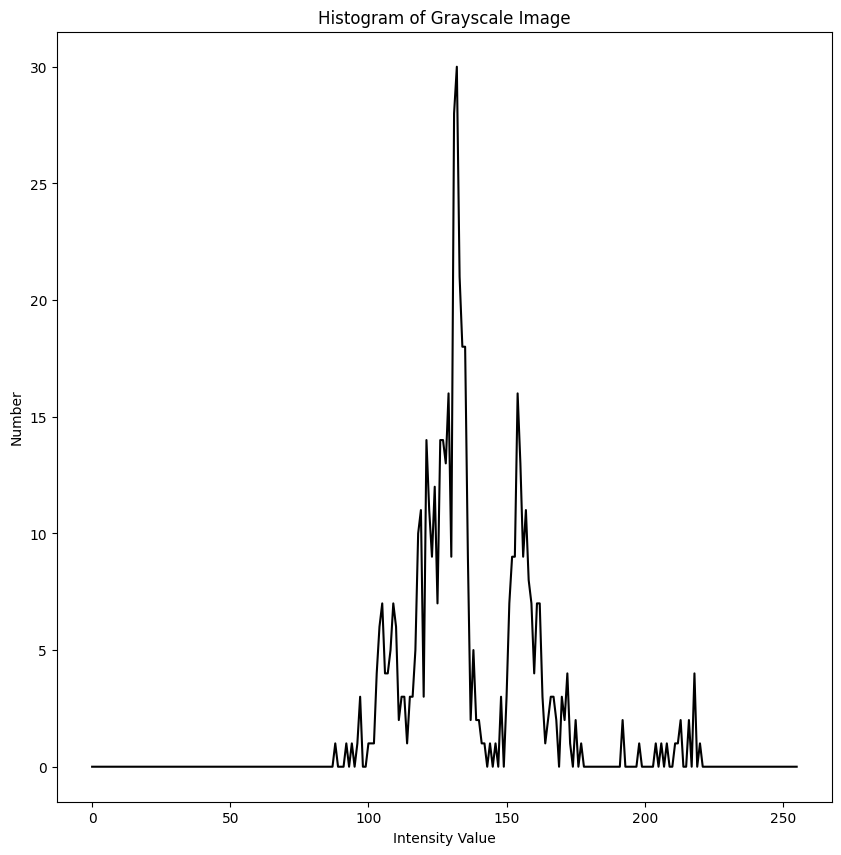

In [ ]:
histogram_gray = cv2.calcHist(img_gray, [0], None, [256], [0, 256])

# Plot Histogram
fig = plt.subplots(1, 1, figsize=(10, 10))
plt.plot(histogram_gray, color='k')
plt.title('Histogram of Grayscale Image')
plt.ylabel('Number')
plt.xlabel('Intensity Value')
plt.show()

### 10.2. Histogram of a color image

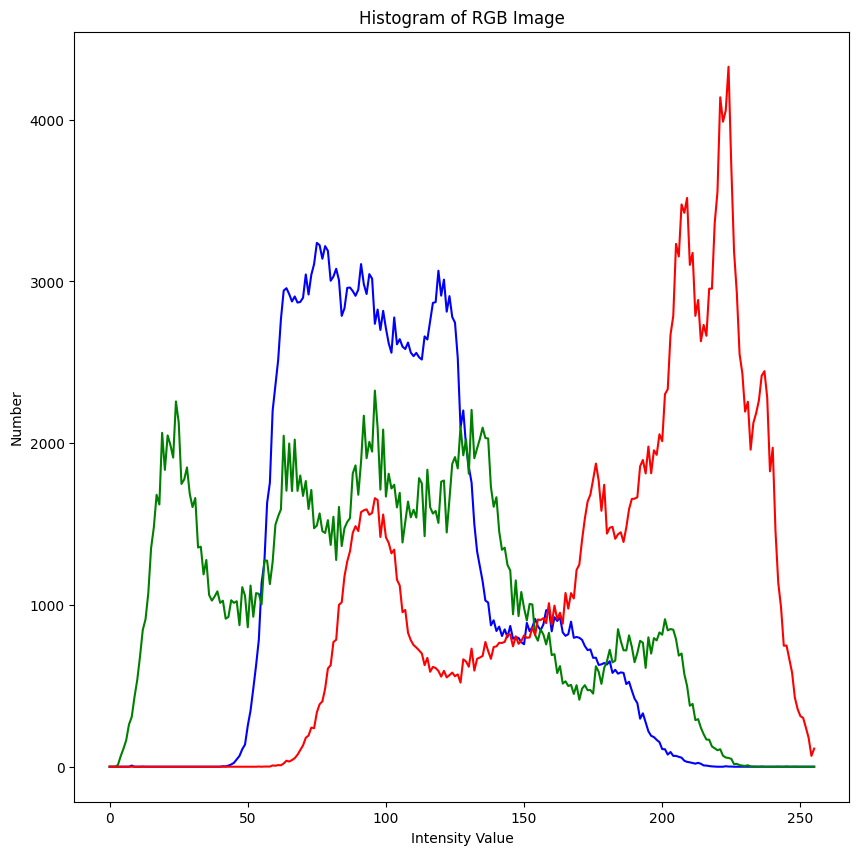

In [ ]:
# Histogram of each BGR image plane
histogram_b = cv2.calcHist([img], [0], None, [256], [0, 256])
histogram_g = cv2.calcHist([img], [1], None, [256], [0, 256])
histogram_r = cv2.calcHist([img], [2], None, [256], [0, 256])

fig = plt.subplots(1, 1, figsize=(10, 10))
plt.plot(histogram_b, color='b')
plt.plot(histogram_g, color='g')
plt.plot(histogram_r, color='r')
plt.title('Histogram of RGB Image')
plt.ylabel('Number')
plt.xlabel('Intensity Value')
plt.show()

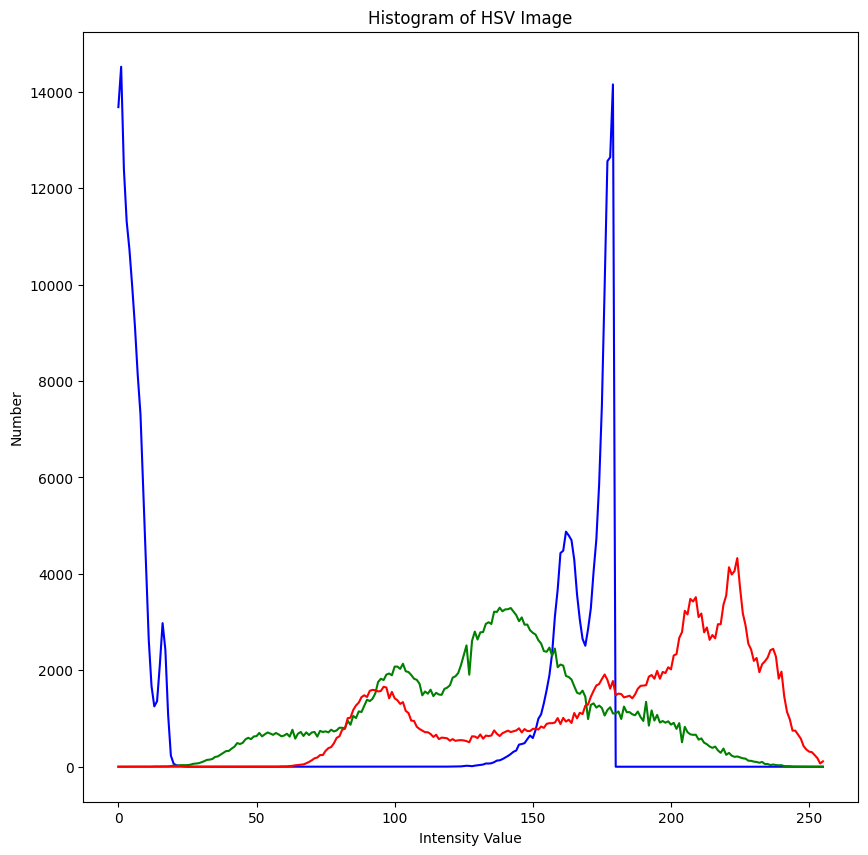

In [ ]:
# Histogram of each HSV image plane
histogram_h = cv2.calcHist([img_hsv], [0], None, [256], [0, 256])
histogram_s = cv2.calcHist([img_hsv], [1], None, [256], [0, 256])
histogram_v = cv2.calcHist([img_hsv], [2], None, [256], [0, 256])

fig = plt.subplots(1, 1, figsize=(10, 10))
plt.plot(histogram_h, color='b')
plt.plot(histogram_s, color='g')
plt.plot(histogram_v, color='r')
plt.title('Histogram of HSV Image')
plt.ylabel('Number')
plt.xlabel('Intensity Value')
plt.show()

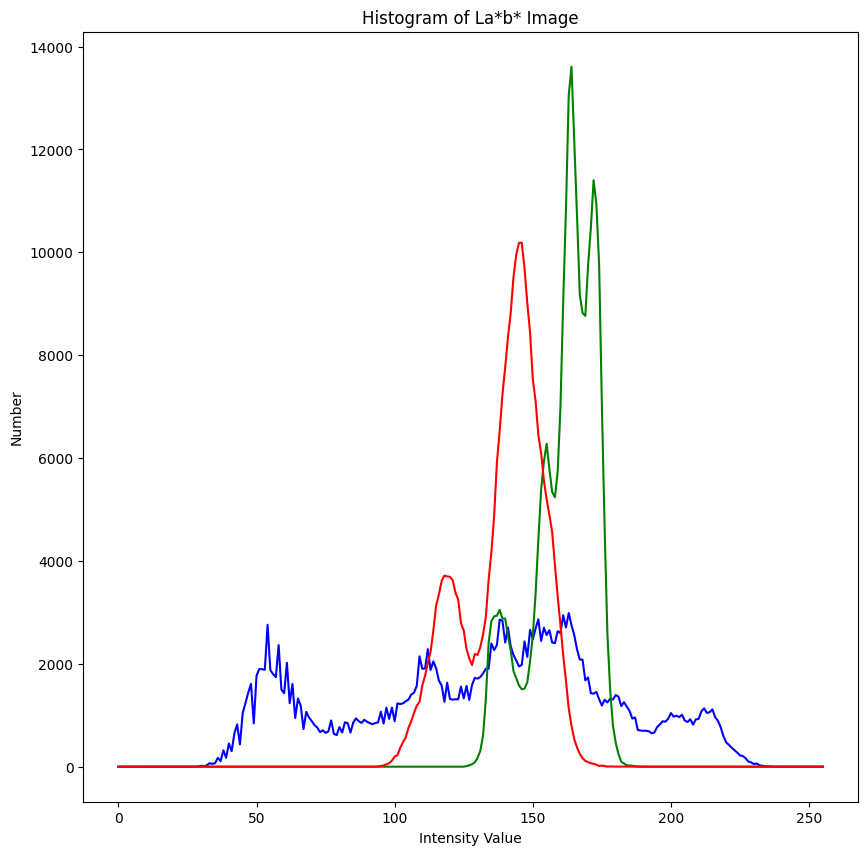

In [ ]:
# Histogram of each L*a*b* image plane
histogram_l = cv2.calcHist([img_lab], [0], None, [256], [0, 256])
histogram_a = cv2.calcHist([img_lab], [1], None, [256], [0, 256])
histogram_b = cv2.calcHist([img_lab], [2], None, [256], [0, 256])

fig = plt.subplots(1, 1, figsize=(10, 10))
plt.plot(histogram_l, color='b')
plt.plot(histogram_a, color='g')
plt.plot(histogram_b, color='r')
plt.title('Histogram of La*b* Image')
plt.ylabel('Number')
plt.xlabel('Intensity Value')
plt.show()

### 10.3. Scatter Plot 2D

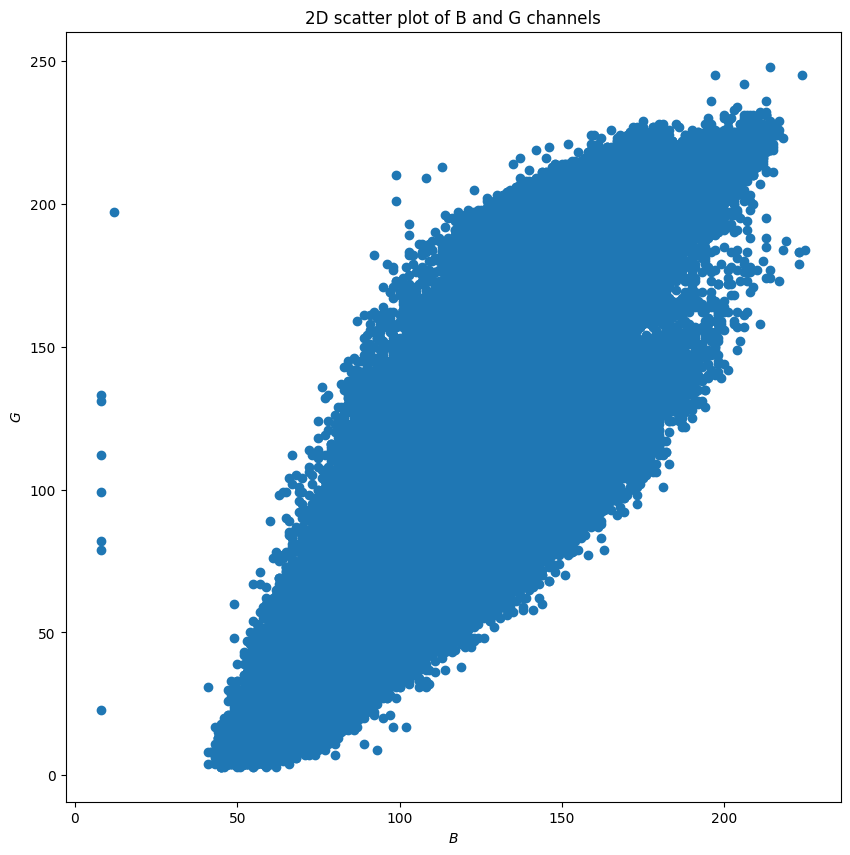

In [ ]:
# plot scatter plot over B and G
pixel_rgb_values = img.reshape((-1, 3))

fig = plt.subplots(1, 1, figsize=(10, 10))
plt.scatter(pixel_rgb_values[:,0], pixel_rgb_values[:,1])
plt.xlabel('$B$', fontsize=10)
plt.ylabel('$G$', fontsize=10)
plt.title('2D scatter plot of B and G channels')
plt.show()

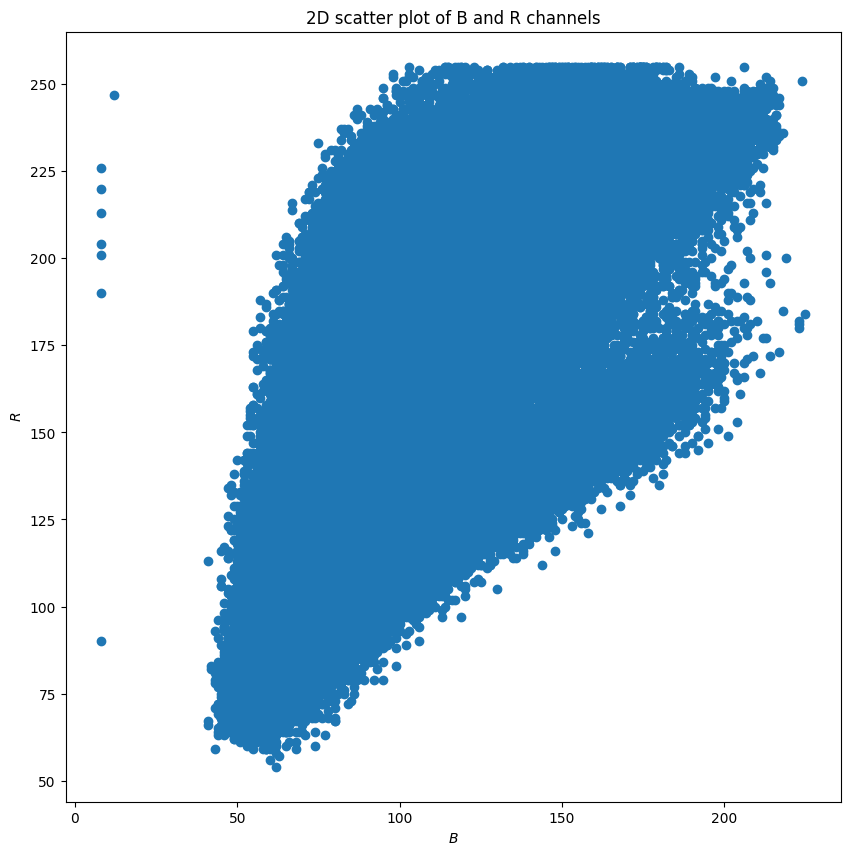

In [ ]:
# plot scatter plot over B and R
pixel_rgb_values = img.reshape((-1, 3))

fig = plt.subplots(1, 1, figsize=(10, 10))
plt.scatter(pixel_rgb_values[:,0], pixel_rgb_values[:,2])
plt.xlabel('$B$', fontsize=10)
plt.ylabel('$R$', fontsize=10)
plt.title('2D scatter plot of B and R channels')
plt.show()

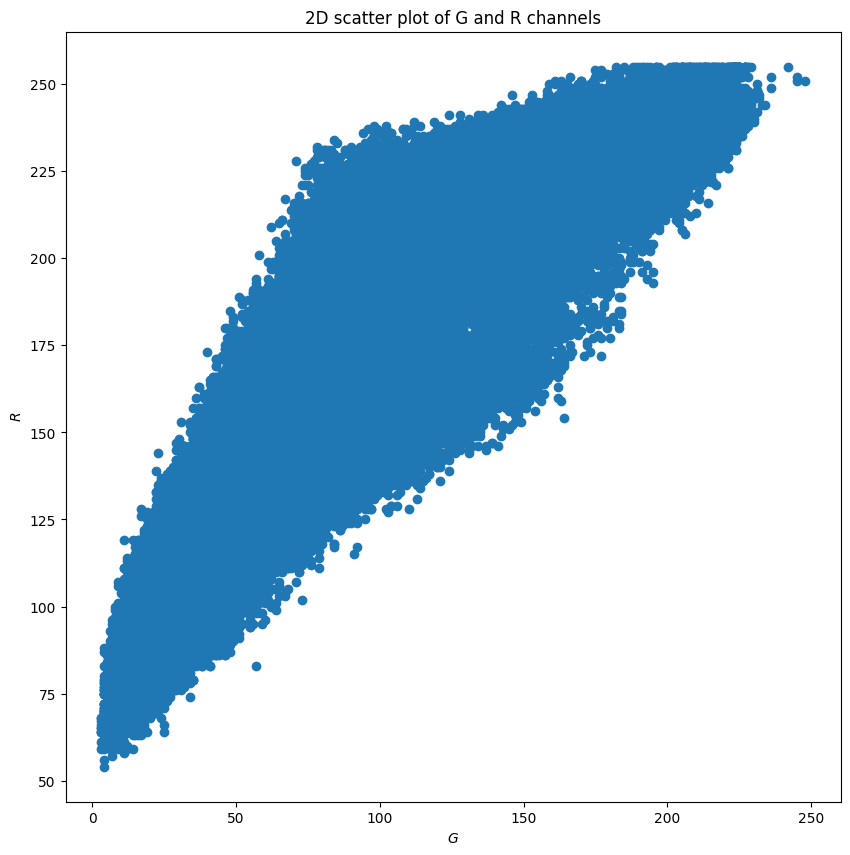

In [ ]:
# plot scatter plot over G and R
pixel_rgb_values = img.reshape((-1, 3))

fig = plt.subplots(1, 1, figsize=(10, 10))
plt.scatter(pixel_rgb_values[:,1], pixel_rgb_values[:,2])
plt.xlabel('$G$', fontsize=10)
plt.ylabel('$R$', fontsize=10)
plt.title('2D scatter plot of G and R channels')
plt.show()

### 10.4. Scatter plot 3D

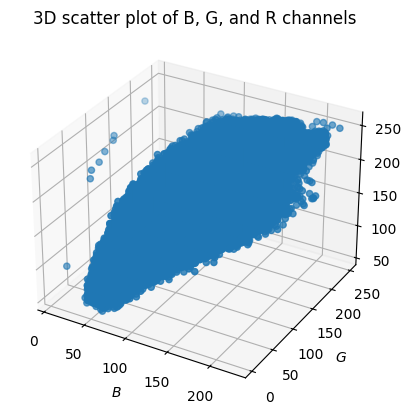

In [ ]:
# plot scatter plot of RGB
pixel_rgb_values = img.reshape((-1, 3))

fig1 = plt.figure()
ax1 = fig1.add_subplot(111, projection='3d')
ax1.scatter(pixel_rgb_values[:,0], pixel_rgb_values[:,1], pixel_rgb_values[:,2])
ax1.set_xlabel('$B$', fontsize=10)
ax1.set_ylabel('$G$', fontsize=10)
ax1.set_zlabel('$R$', fontsize=10)
ax1.set_title('3D scatter plot of B, G, and R channels')
plt.show()

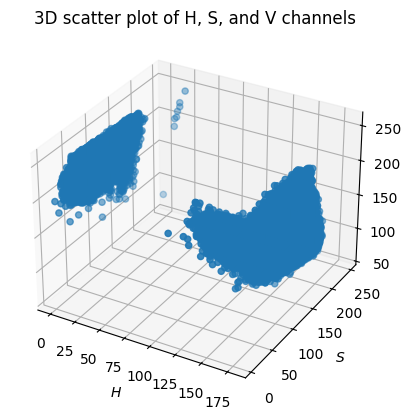

In [ ]:
# plot scatter plot of HSV
pixel_hsv_values = img_hsv.reshape((-1, 3))

fig1 = plt.figure()
ax1 = fig1.add_subplot(111, projection='3d')
ax1.scatter(pixel_hsv_values[:,0], pixel_hsv_values[:,1], pixel_hsv_values[:,2])
ax1.set_xlabel('$H$', fontsize=10)
ax1.set_ylabel('$S$', fontsize=10)
ax1.set_zlabel('$V$', fontsize=10)
ax1.set_title('3D scatter plot of H, S, and V channels')
plt.show()

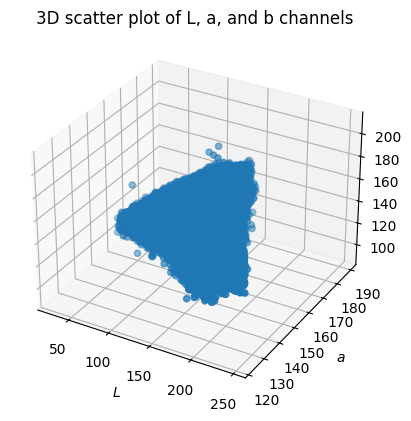

In [ ]:
# plot scatter plot of Lab
pixel_lab_values = img_lab.reshape((-1, 3))

fig1 = plt.figure()
ax1 = fig1.add_subplot(111, projection='3d')
ax1.scatter(pixel_lab_values[:,0], pixel_lab_values[:,1], pixel_lab_values[:,2])
ax1.set_xlabel('$L$', fontsize=10)
ax1.set_ylabel('$a$', fontsize=10)
ax1.set_zlabel('$b$', fontsize=10)
ax1.set_title('3D scatter plot of L, a, and b channels')
plt.show()

## 11. Basic Segmentation

### 11.1. Image Thresholding

This section demonstrates a basic image segmentation technique using thresholding and masking in OpenCV.

**Image Thresholding:**

Thresholding is a simple yet effective method for image segmentation. It works by converting a grayscale image into a binary image based on a threshold value. Pixels with intensity values above the threshold are set to one value (e.g., white), and pixels below the threshold are set to another value (e.g., black). Different types of thresholding exist:

*   **`cv2.THRESH_BINARY`:** Pixels above the threshold are set to the maximum value (e.g., 255), and pixels below are set to 0.
*   **`cv2.THRESH_BINARY_INV`:** The inverse of `THRESH_BINARY`. Pixels above the threshold are set to 0, and pixels below are set to the maximum value.
*   **`cv2.THRESH_TRUNC`:** Pixels above the threshold are set to the threshold value, while pixels below remain unchanged.
*   **`cv2.THRESH_TOZERO`:** Pixels below the threshold are set to 0, while pixels above remain unchanged.
*   **`cv2.THRESH_TOZERO_INV`:** The inverse of `THRESH_TOZERO`. Pixels above the threshold are set to 0, while pixels below remain unchanged.

In the code, `cv2.threshold()` is used to apply these different thresholding methods to the grayscale image (`img_gray`). The first return value (`ret`) is the threshold value used, and the second value (`thresh1`, `thresh2`, etc.) is the resulting binary or thresholded image.

Let read another image:

In [ ]:
import cv2
import sys

img = cv2.imread("Images/blood1.jpg")

if img is None:
    sys.exit("Could not read the image.")

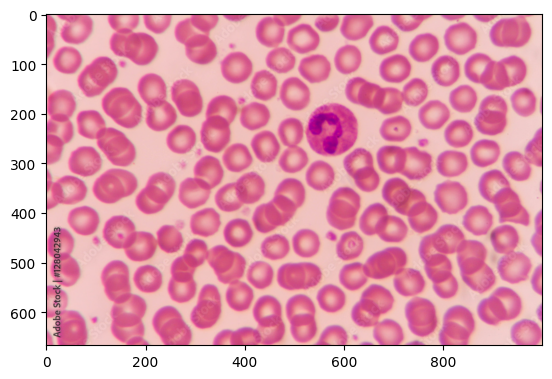

In [ ]:
import matplotlib.pyplot as plt

# display the images
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.show()

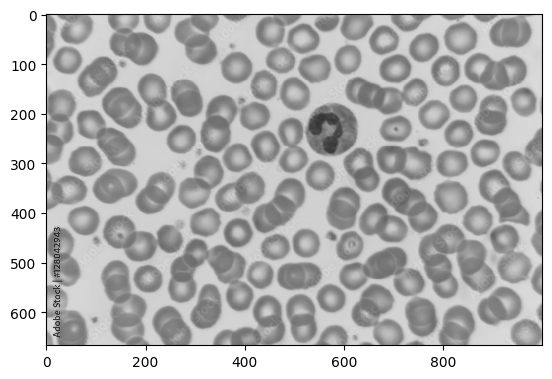

In [ ]:
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

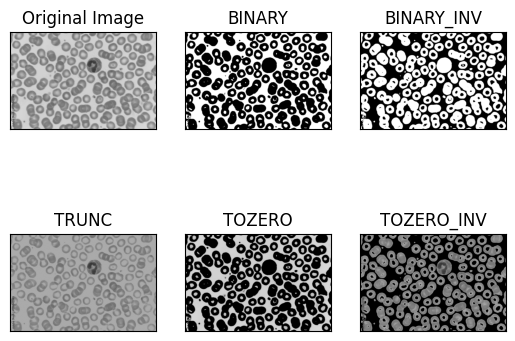

In [ ]:
ret,thresh1 = cv2.threshold(img_gray,170,255,cv2.THRESH_BINARY)
ret,thresh2 = cv2.threshold(img_gray,170,255,cv2.THRESH_BINARY_INV)
ret,thresh3 = cv2.threshold(img_gray,170,255,cv2.THRESH_TRUNC)
ret,thresh4 = cv2.threshold(img_gray,170,255,cv2.THRESH_TOZERO)
ret,thresh5 = cv2.threshold(img_gray,170,255,cv2.THRESH_TOZERO_INV)

titles = ['Original Image','BINARY','BINARY_INV','TRUNC','TOZERO','TOZERO_INV']
images = [img_gray, thresh1, thresh2, thresh3, thresh4, thresh5]

# display the image
for i in range(6):
    plt.subplot(2,3,i+1),plt.imshow(images[i],'gray',vmin=0,vmax=255)
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
plt.show()

**Masking:**

Masking is used to isolate a specific region of interest in an image. A mask is typically a binary image where the pixels in the region of interest have a non-zero value (e.g., 255), and the remaining pixels are zero. The `cv2.bitwise_and()` operation is commonly used for masking. It performs a bitwise AND operation between the original image and the mask. Where the mask has a non-zero value, the corresponding pixel from the original image is retained; where the mask is zero, the output pixel is zero.

In the code, `cv2.bitwise_and(img_gray, img_gray, mask=thresh2)` uses the `thresh2` image (which is the result of `cv2.THRESH_BINARY_INV`) as a mask. This effectively selects the pixels from the grayscale image (`img_gray`) that correspond to the white areas in the `thresh2` mask, resulting in a segmented image where only the objects of interest (the blood cells) are visible.

In [ ]:
# Thresholding and Masking
result = cv2.bitwise_and(img_gray, img_gray, mask=thresh2)

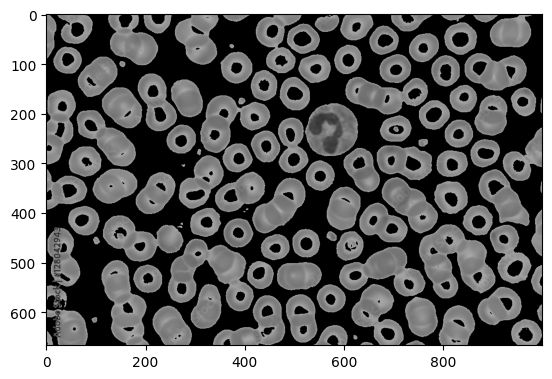

In [ ]:
plt.imshow(result,'gray',vmin=0,vmax=255)

### 11.2. Color segmentation

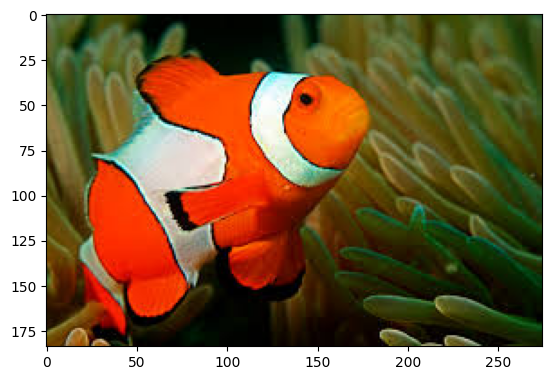

In [ ]:
import cv2
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import colors

from matplotlib.colors import hsv_to_rgb

# Let's look at our fish image
nemo = cv2.imread("Images/nemo0.jpg")
nemo = cv2.cvtColor(nemo, cv2.COLOR_BGR2RGB)
plt.imshow(nemo)
plt.show()

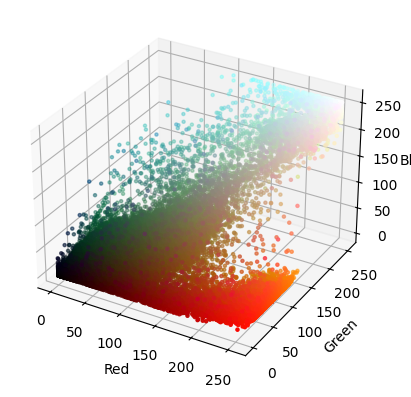

In [ ]:
# Plotting the image on 3D plot
r, g, b = cv2.split(nemo)

fig = plt.figure()
axis = fig.add_subplot(1, 1, 1, projection="3d")
pixel_colors = nemo.reshape((np.shape(nemo)[0] * np.shape(nemo)[1], 3))
norm = colors.Normalize(vmin=-1.0, vmax=1.0)
norm.autoscale(pixel_colors)
pixel_colors = norm(pixel_colors).tolist()

axis.scatter(
    r.flatten(), g.flatten(), b.flatten(), facecolors=pixel_colors, marker="."
)
axis.set_xlabel("Red")
axis.set_ylabel("Green")
axis.set_zlabel("Blue")
plt.show()

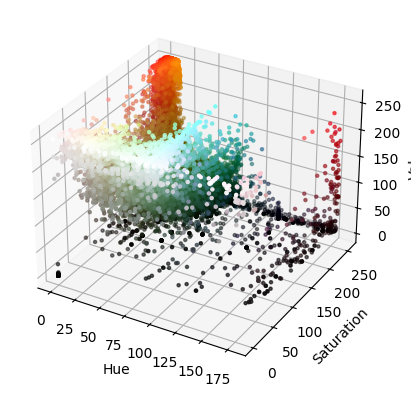

In [ ]:
hsv_nemo = cv2.cvtColor(nemo, cv2.COLOR_RGB2HSV)

h, s, v = cv2.split(hsv_nemo)

fig = plt.figure()
axis = fig.add_subplot(1, 1, 1, projection="3d")

axis.scatter(
    h.flatten(), s.flatten(), v.flatten(), facecolors=pixel_colors, marker="."
)
axis.set_xlabel("Hue")
axis.set_ylabel("Saturation")
axis.set_zlabel("Value")
plt.show()


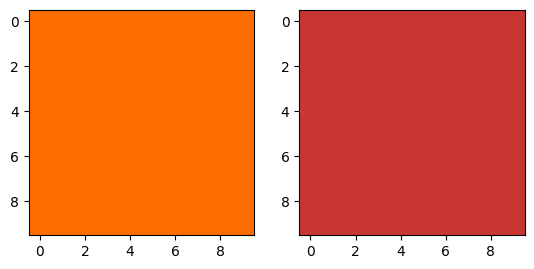

In [ ]:
light_orange = (1, 190, 200)
dark_orange = (18, 255, 255)

# Normalise to 0 - 1 range for viewing

lo_square = np.full((10, 10, 3), light_orange, dtype=np.uint8) / 255.0
do_square = np.full((10, 10, 3), dark_orange, dtype=np.uint8) / 255.0

plt.subplot(1, 2, 1)
plt.imshow(hsv_to_rgb(do_square))
plt.subplot(1, 2, 2)
plt.imshow(hsv_to_rgb(lo_square))
plt.show()

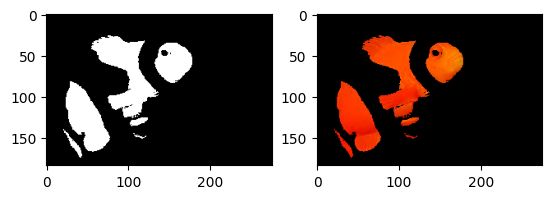

In [ ]:
# Segment Nemo using inRange() function
mask = cv2.inRange(hsv_nemo, light_orange, dark_orange)

# Bitwise-AND mask and original image
result = cv2.bitwise_and(nemo, nemo, mask=mask)

# Convert back to RGB in order to plot using `matplotlib.pyplot`
plt.subplot(1, 2, 1)
plt.imshow(mask, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(result)
plt.show()

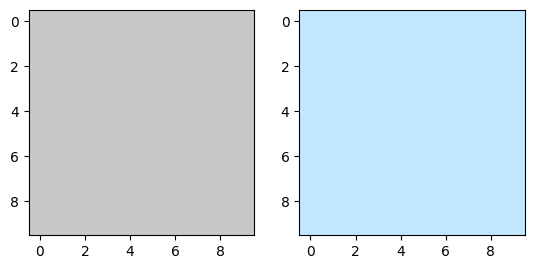

In [ ]:
light_white = (0, 0, 200)
dark_white = (145, 60, 255)

lw_square = np.full((10, 10, 3), light_white, dtype=np.uint8) / 255.0
dw_square = np.full((10, 10, 3), dark_white, dtype=np.uint8) / 255.0

plt.subplot(1, 2, 1)
plt.imshow(hsv_to_rgb(lw_square))
plt.subplot(1, 2, 2)
plt.imshow(hsv_to_rgb(dw_square))
plt.show()



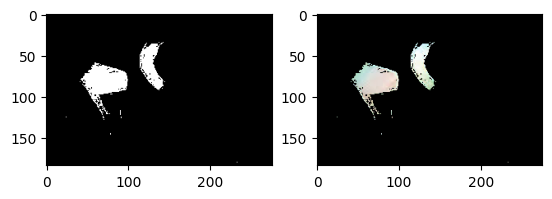

In [ ]:
mask_white = cv2.inRange(hsv_nemo, light_white, dark_white)
result_white = cv2.bitwise_and(nemo, nemo, mask=mask_white)

plt.subplot(1, 2, 1)
plt.imshow(mask_white, cmap="gray")
plt.subplot(1, 2, 2)
plt.imshow(result_white)
plt.show()

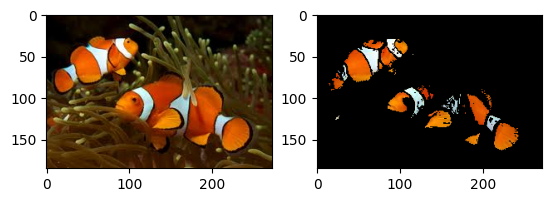

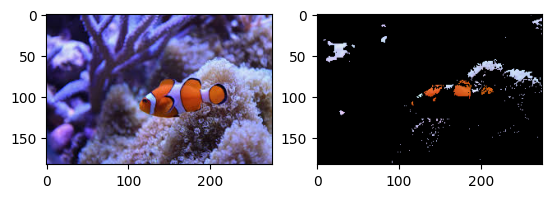

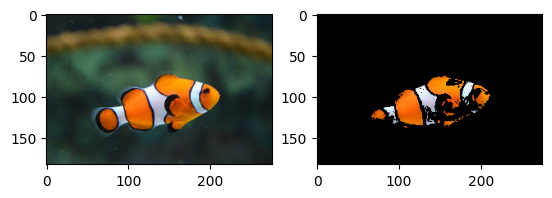

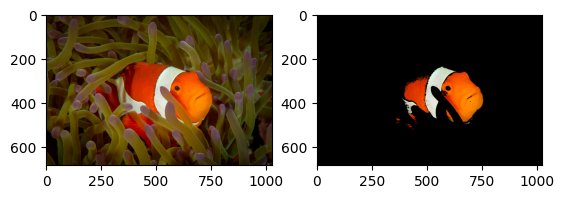

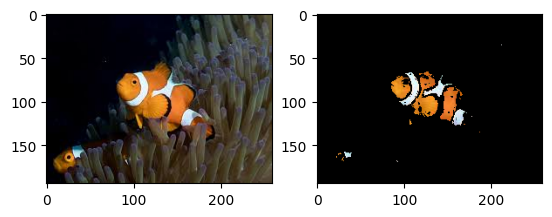

In [ ]:
# Generalising the segmentation

path = "Images/nemo"

nemos_friends = []
for i in range(6):
    friend = cv2.cvtColor(
        cv2.imread(path + str(i) + ".jpg"), cv2.COLOR_BGR2RGB
    )
    nemos_friends.append(friend)

def segment_fish(image):
    """Attempts to segment the clown fish out of the provided image."""
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    light_orange = (1, 190, 200)
    dark_orange = (18, 255, 255)
    mask = cv2.inRange(hsv_image, light_orange, dark_orange)
    light_white = (0, 0, 200)
    dark_white = (145, 60, 255)
    mask_white = cv2.inRange(hsv_image, light_white, dark_white)
    final_mask = mask + mask_white
    result = cv2.bitwise_and(image, image, mask=final_mask)
    # result = cv2.GaussianBlur(result, (7, 7), 0)
    return result

results = [segment_fish(friend) for friend in nemos_friends]

for i in range(1, 6):
    plt.subplot(1, 2, 1)
    plt.imshow(nemos_friends[i])
    plt.subplot(1, 2, 2)
    plt.imshow(results[i])
    plt.show()

### Bonus Assignment #1

In [ ]:
# Assignment 1 Optimize the color range to fully segment the whole body of each Nemo images.
# Try both RGB and HSV

### Bonus Assignment #2

In [ ]:
# Assignment 2 Select a target object of your choice. Write a code to detect the color of target object.
# Try both RGB and HSV.

## 12. Point Operators
Point operations, also known as pixel transforms or intensity transformations, are image processing techniques that modify the intensity of individual pixels independently of their neighboring pixels.

### 12.1. Linear Operation
In this section, we are demonstrating a linear point operation.

In [ ]:
import cv2
import sys

img = cv2.imread("Images/lowlight_1.jpg" )

if img is None:
    sys.exit("Could not read the image.")

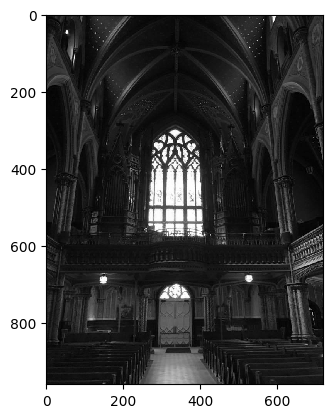

In [ ]:
import matplotlib.pyplot as plt

img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

A linear operation on an image pixel's intensity value can be represented by the formula:

$g(i, j) = a f(i, j) + b$

Where:
*   $f(i, j)$ is the intensity of the pixel at coordinates $(i, j)$ in the input image.
*   $g(i, j)$ is the intensity of the corresponding pixel in the output image.
*   $a$ is a multiplicative factor that affects the contrast of the image. A value of $a$ greater than 1 increases the contrast, while a value between 0 and 1 decreases it.
*   $b$ is an additive factor that affects the brightness of the image. A positive value of $b$ increases the brightness, while a negative value of $b$ decreases it.

This type of linear transformation is a simple yet effective way to adjust the brightness and contrast of an image for basic image enhancement.

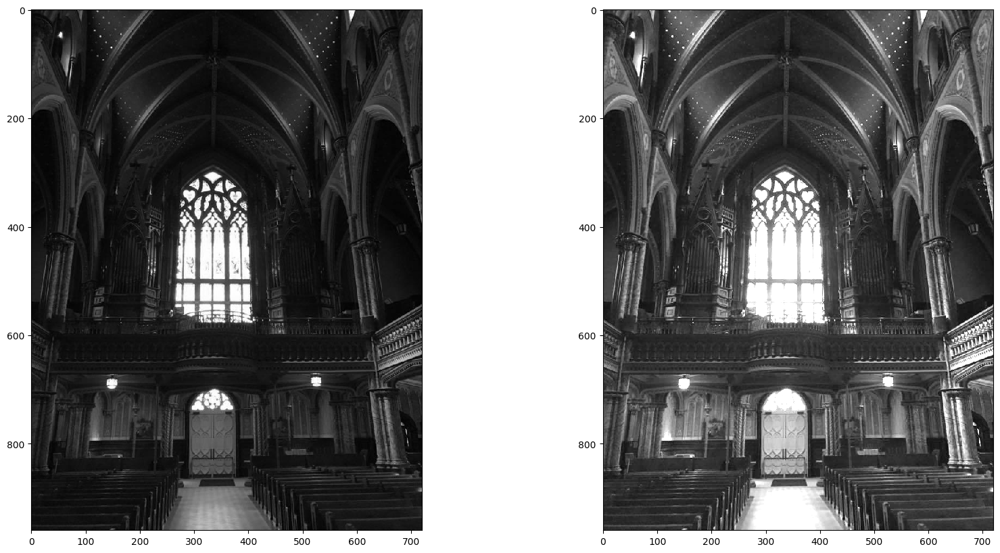

In [ ]:
# Try to vary this gain and bias numbers, and see the result
gain = 2.0
bias = 10

img_gray_edited = gain*img_gray + bias
img_gray_edited_unit8 = np.clip(img_gray_edited, 0, 255).astype('uint8')

# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(img_gray_edited_unit8, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

Let visualize it in histogram !

Text(0.5, 0, 'Intensity Value')

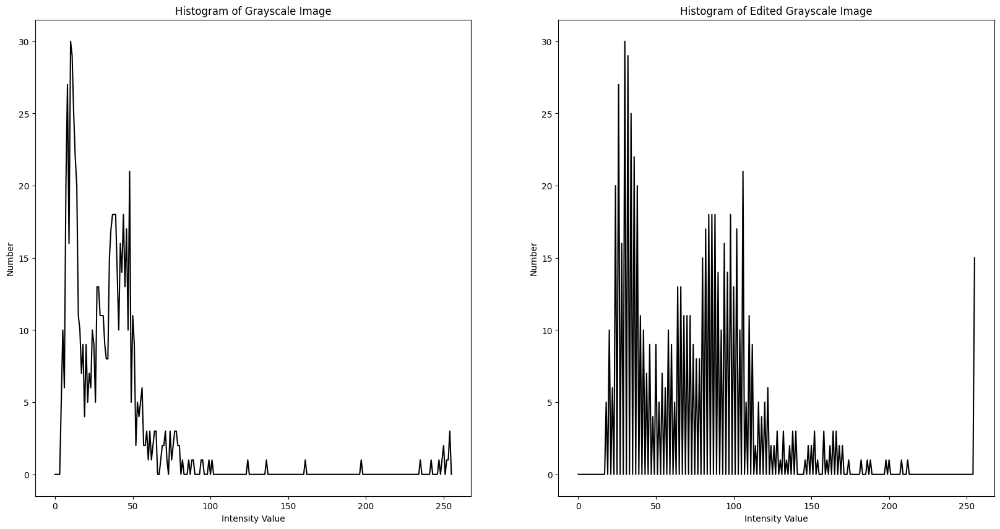

In [ ]:
histogram_gray = cv2.calcHist(img_gray, [0], None, [256], [0, 256])
histogram_gray_edit = cv2.calcHist(img_gray_edited_unit8, [0], None, [256], [0, 256])

# Plot Histogram
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.plot(histogram_gray, color='k')
ax1.set_title('Histogram of Grayscale Image')
ax1.set_ylabel('Number')
ax1.set_xlabel('Intensity Value')

ax2.plot(histogram_gray_edit, color='k')
ax2.set_title('Histogram of Edited Grayscale Image')
ax2.set_ylabel('Number')
ax2.set_xlabel('Intensity Value')


### 12.2. Gamma Correction

Gamma correction is a non-linear point operation used to adjust the brightness and contrast of an image. It is particularly useful for correcting images that appear too dark or too bright, often due to the characteristics of display devices or image acquisition systems.

The formula for gamma correction is:

$O(i, j) = c \times (f(i, j))^\gamma$

Where:
*   $f(i, j)$ is the intensity of the pixel at coordinates $(i, j)$ in the input image (typically normalized to the range [0, 1]).
*   $O(i, j)$ is the intensity of the corresponding pixel in the output image (also in the range [0, 1]).
*   $c$ is a constant (often 1).
*   $\gamma$ (gamma) is the exponent that controls the correction.

*   If $\gamma < 1$, the image becomes brighter.
*   If $\gamma > 1$, the image becomes darker.
*   If $\gamma = 1$, there is no change.


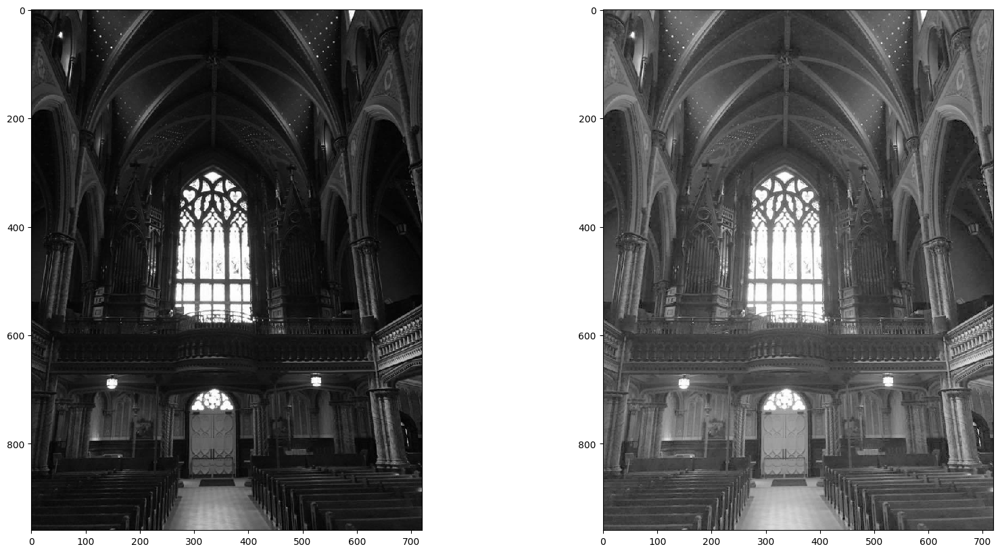

In [ ]:
# Try to vary gamma
gamma = 0.5

lookUpTable = np.empty((1,256), np.uint8)
for i in range(256):
    lookUpTable[0,i] = np.clip(pow(i / 255.0, gamma) * 255.0, 0, 255)

image_gray_gamma = cv2.LUT(img_gray, lookUpTable)

# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(image_gray_gamma, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

Text(0.5, 0, 'Intensity Value')

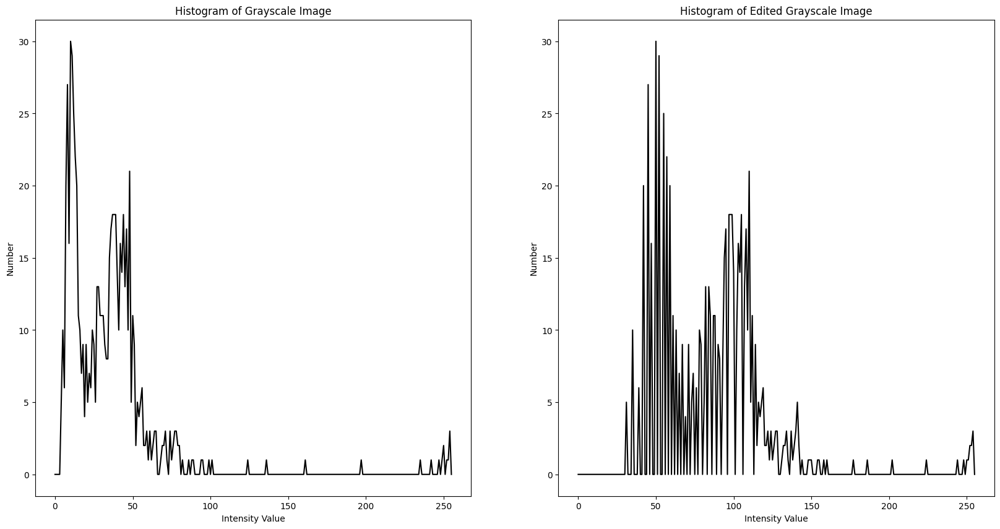

In [ ]:
histogram_gray = cv2.calcHist(img_gray, [0], None, [256], [0, 256])
histogram_gray_edit = cv2.calcHist(image_gray_gamma, [0], None, [256], [0, 256])

# Plot Histogram
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.plot(histogram_gray, color='k')
ax1.set_title('Histogram of Grayscale Image')
ax1.set_ylabel('Number')
ax1.set_xlabel('Intensity Value')

ax2.plot(histogram_gray_edit, color='k')
ax2.set_title('Histogram of Edited Grayscale Image')
ax2.set_ylabel('Number')
ax2.set_xlabel('Intensity Value')

In [ ]:
# Add your code here for RGB color image.
# Try to adjust the color intensity using Histogram Equalization.
# Try other color space (e.g. L*a*b*)

### 12.3 Histogram Equalization

Histogram Equalization is an image processing technique used to improve the contrast of an image. It works by effectively spreading out the most frequent intensity values, i.e., lengthening the intensity range of the pixels that have the highest frequencies in the histogram. This allows for areas of lower local contrast to gain a higher contrast.

For a grayscale image, the process involves calculating the histogram, computing a cumulative distribution function (CDF), and then using the CDF to map the original pixel intensity values to new values such that the resulting histogram is approximately uniform.

OpenCV provides the `cv2.equalizeHist()` function, which performs histogram equalization on a single-channel (grayscale) image.

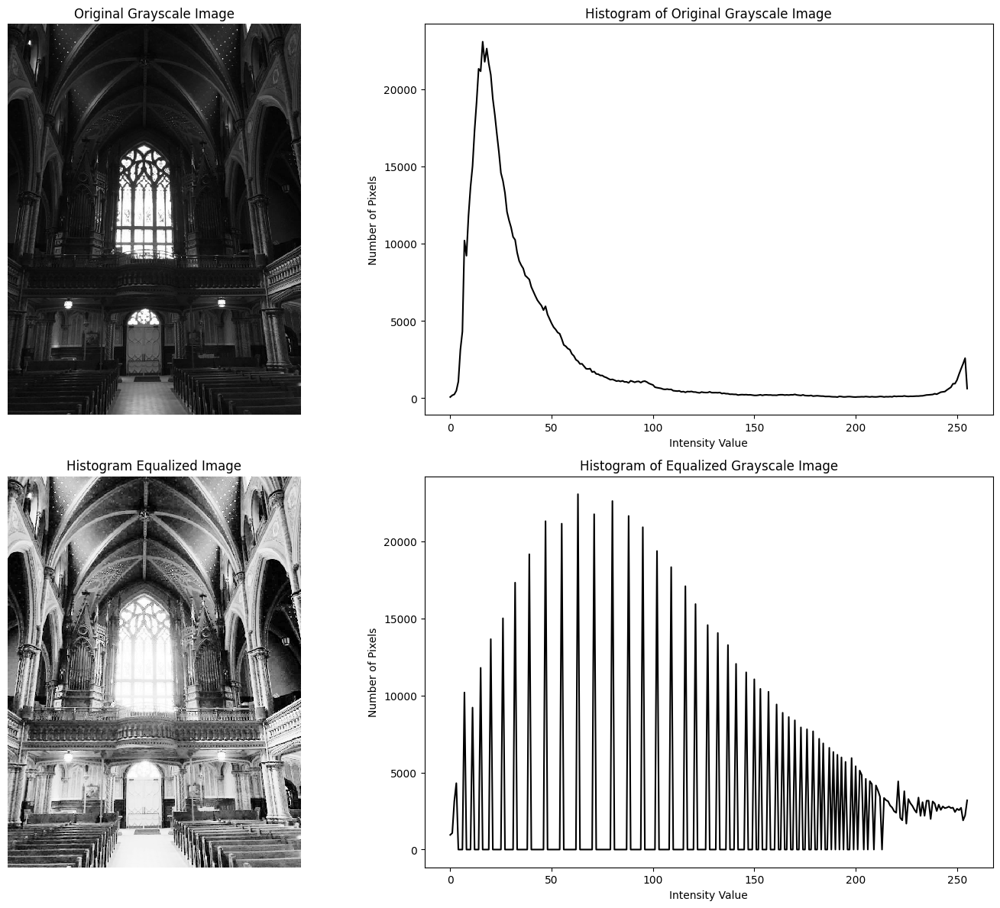

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Assuming 'img_gray' is your grayscale image from previous steps

# Apply histogram equalization
img_gray_equalized = cv2.equalizeHist(img_gray)

# Calculate histograms for the original and equalized images
histogram_gray = cv2.calcHist([img_gray], [0], None, [256], [0, 256])
histogram_gray_equalized = cv2.calcHist([img_gray_equalized], [0], None, [256], [0, 256])

# Display the original and equalized images and their histograms
fig, axes = plt.subplots(2, 2, figsize=(15, 12))

# Original Image and Histogram
axes[0, 0].imshow(img_gray, cmap='gray', vmin=0, vmax=255, interpolation='none')
axes[0, 0].set_title('Original Grayscale Image')
axes[0, 0].axis('off')

axes[0, 1].plot(histogram_gray, color='k')
axes[0, 1].set_title('Histogram of Original Grayscale Image')
axes[0, 1].set_xlabel('Intensity Value')
axes[0, 1].set_ylabel('Number of Pixels')

# Equalized Image and Histogram
axes[1, 0].imshow(img_gray_equalized, cmap='gray', vmin=0, vmax=255, interpolation='none')
axes[1, 0].set_title('Histogram Equalized Image')
axes[1, 0].axis('off')

axes[1, 1].plot(histogram_gray_equalized, color='k')
axes[1, 1].set_title('Histogram of Equalized Grayscale Image')
axes[1, 1].set_xlabel('Intensity Value')
axes[1, 1].set_ylabel('Number of Pixels')

plt.tight_layout()
plt.show()

### Bonus Assignment #3

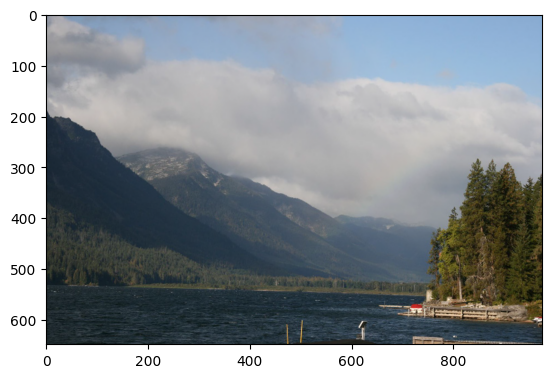

In [118]:
# Read the image "rainbow.png". Apparently, there is a rainbow on this image!
# If you try hard enough, we can see the rainbow.
# Those who can give me the rainbow will get a bonus point

import cv2
import sys

img = cv2.imread("Images/rainbow.png" )

if img is None:
    sys.exit("Could not read the image.")

# display the images
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.show()


#### Write your code here:


### 12.4. Limitation of Point Processing

Let try to sramble the pixels randomly. We first reshape the image into a 1D array, randomly shuffle the pixel values, and then reshape it back to the original image dimensions.


In [ ]:
img = cv2.imread("Images/lenna.png")

if img is None:
    sys.exit("Could not read the image.")

# Convert to grayscale
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

In [ ]:
# Get the shape of the original grayscale image
original_shape_gray = img_gray.shape

# Reshape the grayscale image into a 1D array of pixel values
pixel_values_gray = img_gray.reshape(-1)

# Create a copy of the reshaped array
scrambled_pixel_values_gray = pixel_values_gray.copy()

# Randomly shuffle the elements of the copied 1D array
np.random.shuffle(scrambled_pixel_values_gray)

# Reshape the shuffled array back to the original grayscale image dimensions
img_scrambled_gray = scrambled_pixel_values_gray.reshape(original_shape_gray)

Then, observe the histogram of both images

In [ ]:
# Calculate histograms for the original and scrambled grayscale images
histogram_gray_original = cv2.calcHist([img_gray], [0], None, [256], [0, 256])
histogram_gray_scrambled = cv2.calcHist([img_scrambled_gray], [0], None, [256], [0, 256])

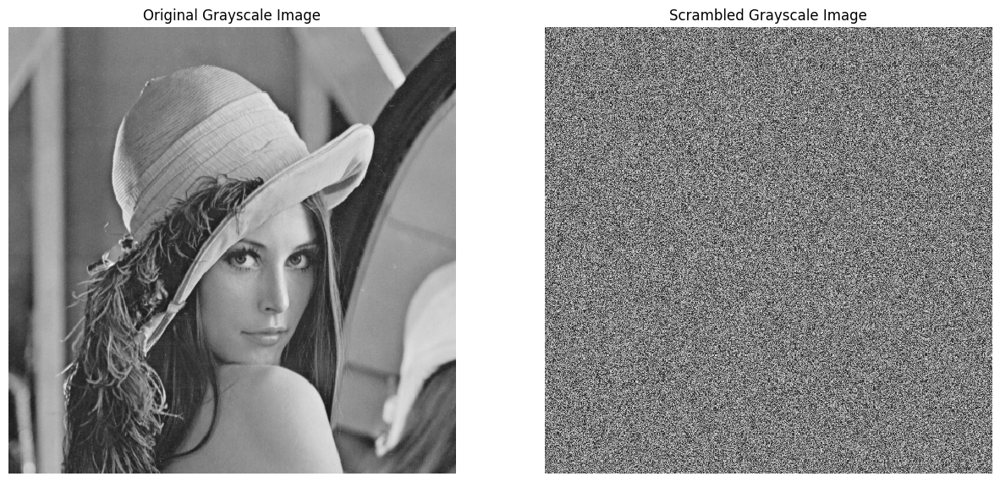

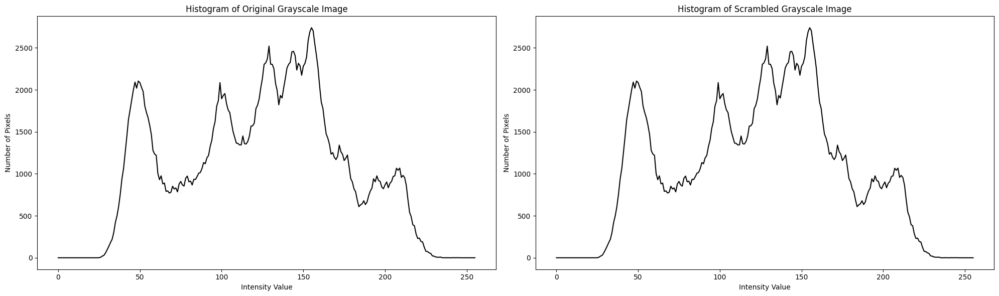

In [ ]:
# Display the original and scrambled grayscale images
fig, axes = plt.subplots(1, 2, figsize=(15, 10))
axes[0].imshow(img_gray, cmap='gray', vmin=0, vmax=255, interpolation='none')
axes[0].set_title('Original Grayscale Image')
axes[0].axis('off')

axes[1].imshow(img_scrambled_gray, cmap='gray', vmin=0, vmax=255, interpolation='none')
axes[1].set_title('Scrambled Grayscale Image')
axes[1].axis('off')

plt.show()

# Plot the histograms for comparison separately
fig, axes = plt.subplots(1, 2, figsize=(20, 6))

# Original grayscale histogram
axes[0].plot(histogram_gray_original, color='k')
axes[0].set_title('Histogram of Original Grayscale Image')
axes[0].set_xlabel('Intensity Value')
axes[0].set_ylabel('Number of Pixels')

# Scrambled grayscale histogram
axes[1].plot(histogram_gray_scrambled, color='k')
axes[1].set_title('Histogram of Scrambled Grayscale Image')
axes[1].set_xlabel('Intensity Value')
axes[1].set_ylabel('Number of Pixels')

plt.tight_layout()
plt.show()

## 13. Linear Filtering

### 13.1. Convolution

In [ ]:
img_gray = cv2.imread('Images/comp_noise.png', cv2.IMREAD_GRAYSCALE)

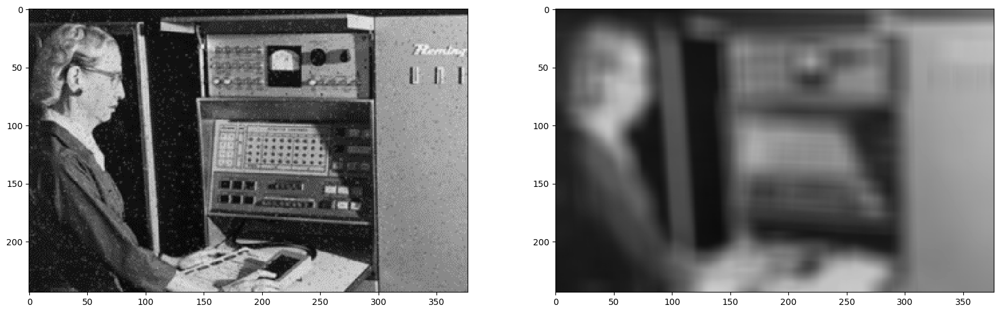

In [ ]:
# Create your own filter
kernel_size = 20

# Add you code here for creating a kernel matrix
kernel = np.ones((kernel_size, kernel_size), dtype=np.float32)
kernel /= (kernel_size * kernel_size)

img_filtered = cv2.filter2D(img_gray, -1, kernel, cv2.BORDER_DEFAULT)

# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(img_filtered, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

Check out the flags for border settings here:
https://docs.opencv.org/3.4/d2/de8/group__core__array.html#ga209f2f4869e304c82d07739337eae7c5

In [ ]:
print(kernel)

[[0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 

### 13.2. Blur filters (Low pass filters)

#### Box filter

In [ ]:
img_gray = cv2.imread('Images/comp_noise.png', cv2.IMREAD_GRAYSCALE)


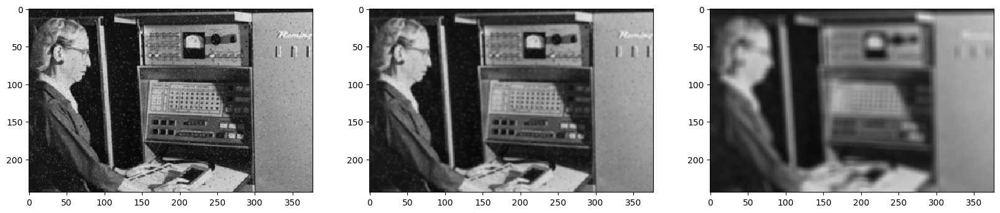

In [ ]:
# Box filter
img_blur_box1 = cv2.blur(img_gray,(3,3))
img_blur_box2 = cv2.blur(img_gray,(10,10))


# display the images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(img_blur_box1, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax3.imshow(img_blur_box2, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

#### Gaussian filter

In [ ]:
img_gray = cv2.imread('Images/comp_noise.png', cv2.IMREAD_GRAYSCALE)

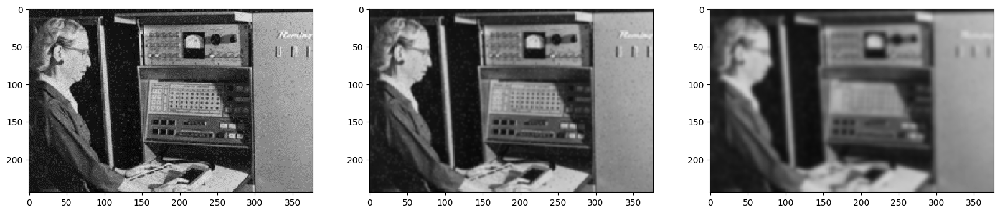

In [ ]:
#gaussian filter
img_blur_gauss1 = cv2.GaussianBlur(img_gray, (5,5), 0)
img_blur_gauss2 = cv2.GaussianBlur(img_gray, (15,15), 0)

# display the images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(img_blur_gauss1, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax3.imshow(img_blur_gauss2, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

### 13.3. Edge detection

#### Sobel operators

In [ ]:
img_gray = cv2.imread('Images/comp_noise.png', cv2.IMREAD_GRAYSCALE)

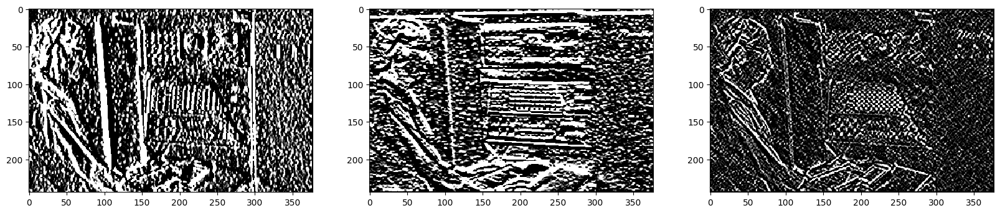

In [ ]:
# Sobel Edge Detection
sobelx = cv2.Sobel(src=img_gray, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5) # Sobel Edge Detection on the X axis
sobely = cv2.Sobel(src=img_gray, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5) # Sobel Edge Detection on the Y axis
sobelxy = cv2.Sobel(src=img_gray, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5) # Combined X and Y Sobel Edge Detection

# display the images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(sobelx, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(sobely, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax3.imshow(sobelxy, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

#### Canny edge detector

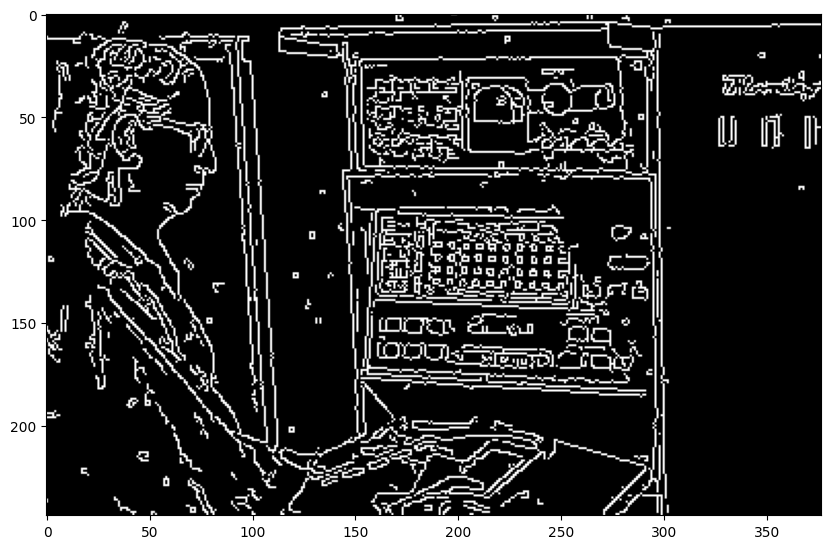

In [ ]:
# Canny Edge Detection
canny_edges = cv2.Canny(image=img_gray, threshold1=100, threshold2=200) # Canny Edge Detection

# display the image
fig = plt.subplots(1, 1, figsize=(10, 10))
plt.imshow(cv2.cvtColor(canny_edges, cv2.COLOR_BGR2RGB))
plt.show()

### 13.4. Sharpening (Unsharp masking)

In [ ]:
img_gray = cv2.imread('Images/pout.tif', cv2.IMREAD_GRAYSCALE)

In [ ]:
img_blur_gauss = cv2.GaussianBlur(img_gray, (5,5), 0)

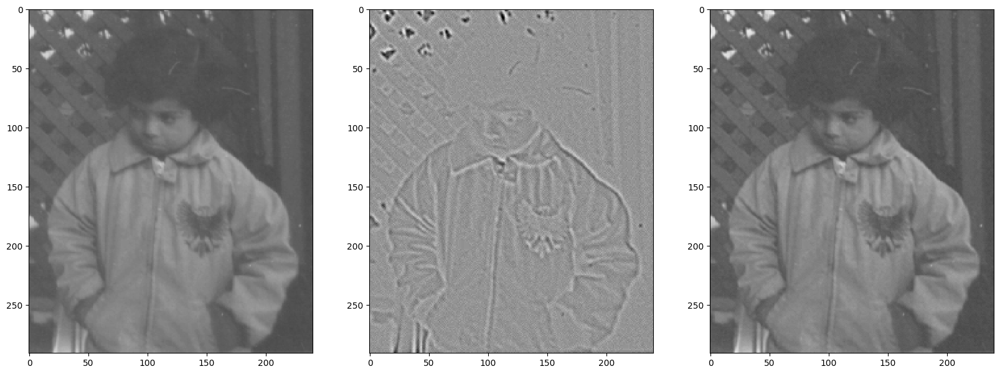

In [ ]:
gamma = 0.7

lap = cv2.Laplacian(img_blur_gauss, cv2.CV_64F)

img_sharp = img_gray - gamma*lap

# display the images
lap_show = np.zeros(lap.shape)
cv2.normalize(lap, lap_show, 0, 255, cv2.NORM_MINMAX)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(lap_show, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax3.imshow(img_sharp, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

## 14. Non-linear filters

### 14.1. Median filter

In [ ]:
img_gray = cv2.imread('Images/comp_noise.png', cv2.IMREAD_GRAYSCALE)

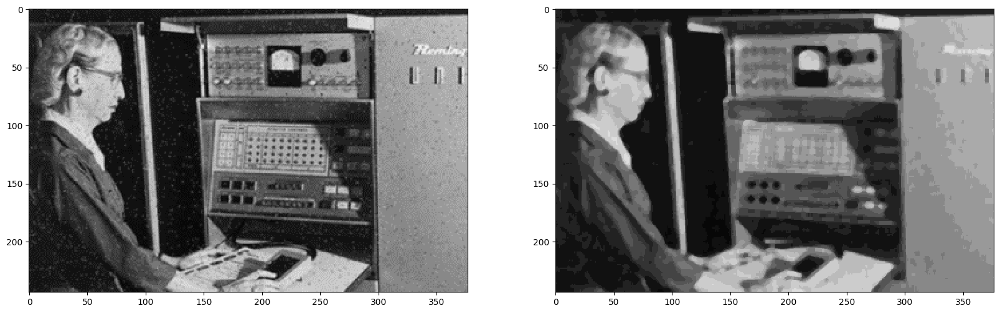

In [ ]:
# Median filter
img_gray_median = cv2.medianBlur(img_gray,5)

# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(img_gray_median, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

### 14.2. Morphological operation

#### Dilation & Erosion

In [ ]:
img_gray = cv2.imread('Images/text.png', cv2.IMREAD_GRAYSCALE)

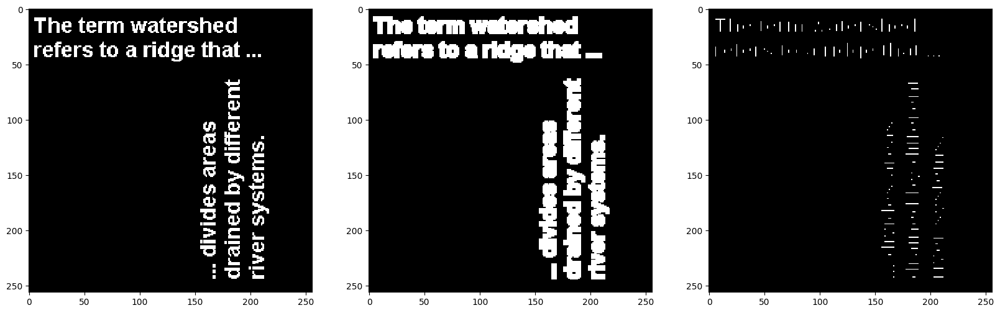

In [ ]:
kernel = np.ones((3,3),np.uint8)
dilate = cv2.dilate(img_gray, kernel,iterations = 1)
erode = cv2.erode(img_gray, kernel,iterations = 1)

# display the images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(dilate, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax3.imshow(erode, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

#### Openning

In [ ]:
img_gray = cv2.imread('Images/snowflakes.png', cv2.IMREAD_GRAYSCALE)

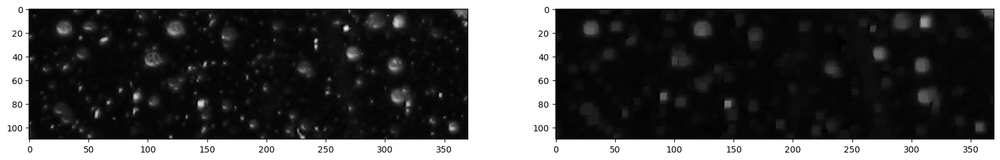

In [ ]:
kernel = np.ones((5,5),np.uint8)
opening = cv2.morphologyEx(img_gray, cv2.MORPH_OPEN, kernel)

# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(opening, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

#### Closing

In [ ]:
img_gray = cv2.imread('Images/circles.png', cv2.IMREAD_GRAYSCALE)

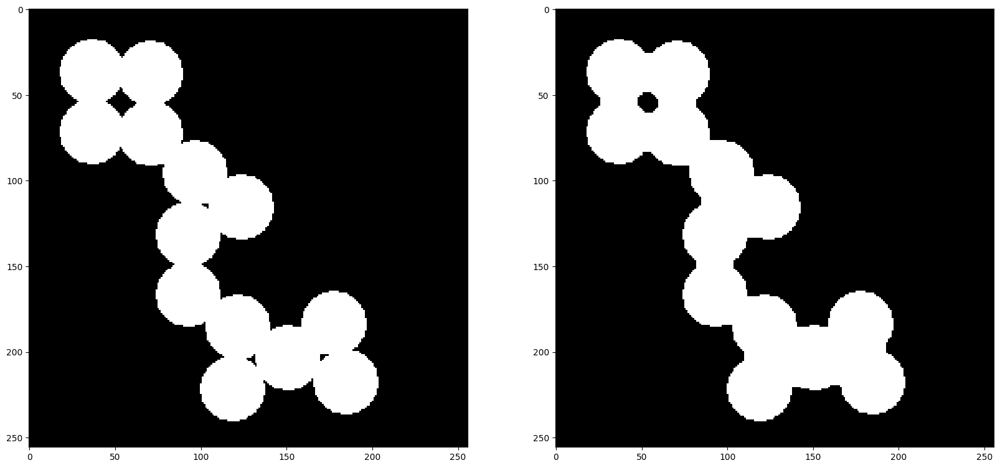

In [ ]:
kernel = np.ones((5,5),np.uint8)
closing = cv2.morphologyEx(img_gray, cv2.MORPH_CLOSE, kernel)

# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(closing, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

## Bonus Assignment #4: Try this tutorial with color image

In [ ]:
# Assignment 1: Try this tutorial with color image

## Bonus Assignment #5: Counting the blood cells

In [ ]:
# Assignment 2: Counting the blood cells
# First, you will perform the thresholding to segment the blood cells as binary image
# Most of the time this segment is not perfect. You will have holes, islands, or unessesary segmentation
# Use cv2.findContours to get a bounding box around all detected contours.
# You can read how to detect contour after segmentation and get the bounding boxes from here:
# https://thinkinfi.com/find-contours-with-opencv-in-python/

img = cv2.imread('Images/blood1.jpg')
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

# Add your code here

## 15. Frequency Analysis

### 15.1. Fourier Transform in 1D

#### Create your own waveform

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

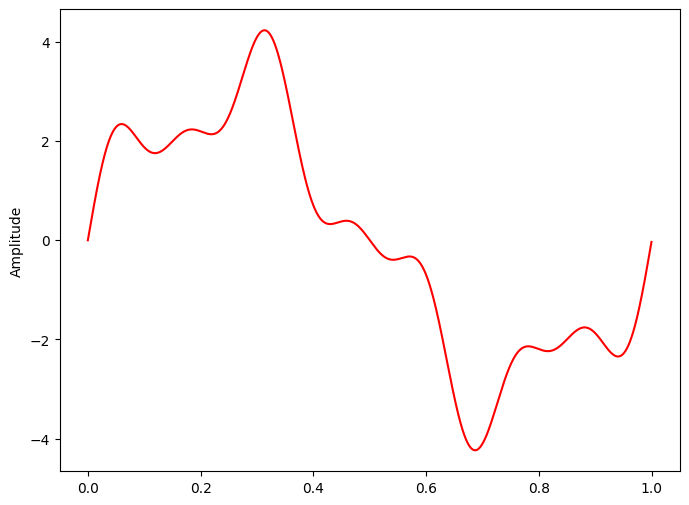

In [ ]:
# sampling rate
sr = 2000
# sampling interval
ts = 1.0/sr
t = np.arange(0,1,ts)

freq = 1.
x = 3*np.sin(2*np.pi*freq*t)

freq = 4
x += np.sin(2*np.pi*freq*t)

freq = 7
x += 0.5* np.sin(2*np.pi*freq*t)


plt.figure(figsize = (8, 6))
plt.plot(t, x, 'r')
plt.ylabel('Amplitude')

plt.show()

/usr/local/lib/python3.12/dist-packages/matplotlib/cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/usr/local/lib/python3.12/dist-packages/matplotlib/cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


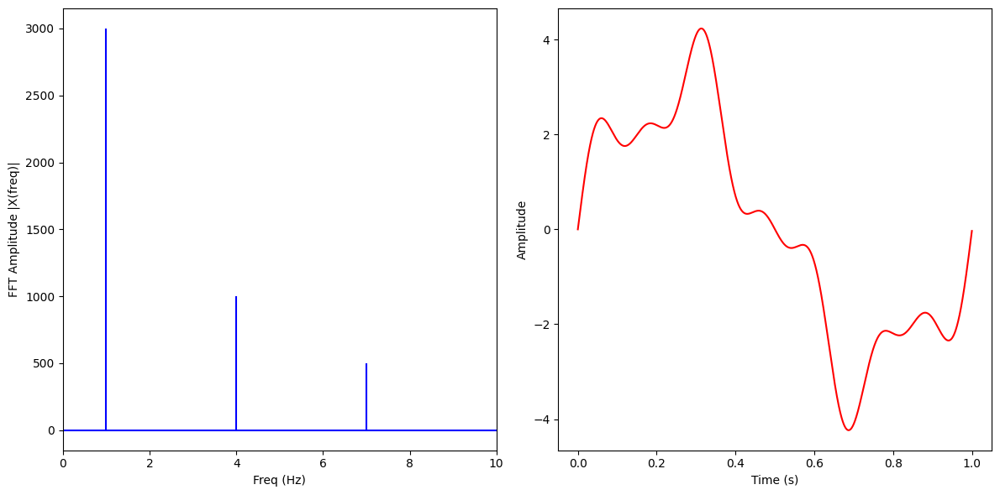

In [ ]:
from numpy.fft import fft, ifft

X = fft(x)
N = len(X)
n = np.arange(N)
T = N/sr
freq = n/T

plt.figure(figsize = (12, 6))
plt.subplot(121)

plt.stem(freq, np.abs(X), 'b', \
         markerfmt=" ", basefmt="-b")
plt.xlabel('Freq (Hz)')
plt.ylabel('FFT Amplitude |X(freq)|')
plt.xlim(0, 10)

plt.subplot(122)
plt.plot(t, ifft(X), 'r')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.tight_layout()
plt.show()

### 15.2. 2D Fourier Transform

2D Fourier Transform of simple 2D signals

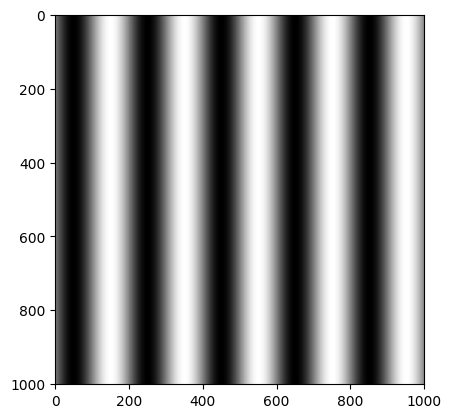

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

x = np.arange(-500, 501, 1)
X, Y = np.meshgrid(x, x)
wavelength = 200
angle = 0
grating = np.sin(
    2*np.pi*(X*np.cos(angle) + Y*np.sin(angle)) / wavelength
)

plt.set_cmap("gray")
plt.imshow(grating)
plt.show()


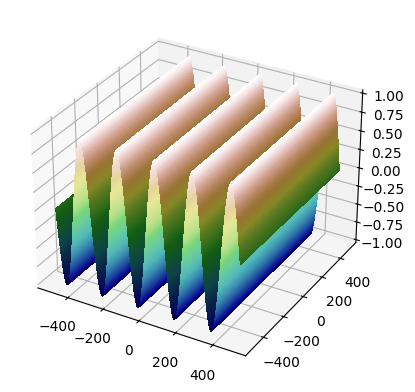

In [ ]:
## This take a lot of time to run. You can try it later.

from matplotlib.colors import LightSource
from matplotlib import cbook, cm

# Set up plot
fig, ax = plt.subplots(subplot_kw=dict(projection='3d'))

ls = LightSource(270, 45)
# To use a custom hillshading mode, override the built-in shading and pass
# in the rgb colors of the shaded surface calculated from "shade".
rgb = ls.shade(grating, cmap=cm.gist_earth, vert_exag=0.1, blend_mode='soft')
surf = ax.plot_surface(X, Y, grating, rstride=1, cstride=1, facecolors=rgb,
                       linewidth=0, antialiased=False, shade=False)

plt.show()

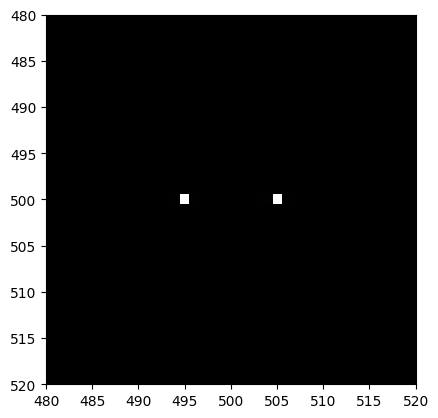

In [ ]:
# Calculate Fourier transform of grating
ft = np.fft.ifftshift(grating)
ft = np.fft.fft2(ft)
ft = np.fft.fftshift(ft)
plt.imshow(abs(ft))
plt.xlim([480, 520])
plt.ylim([520, 480])
plt.show()

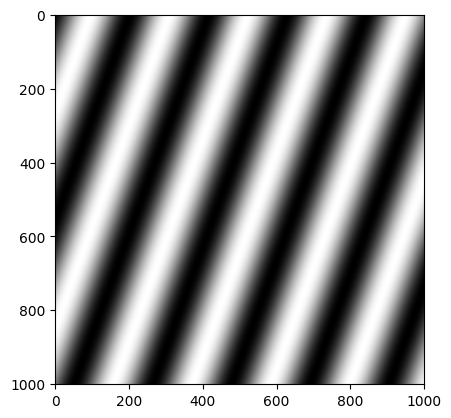

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

x = np.arange(-500, 501, 1)
X, Y = np.meshgrid(x, x)
wavelength = 200
angle = np.pi / 9
grating = np.sin(
    2*np.pi*(X*np.cos(angle) + Y*np.sin(angle)) / wavelength
)

plt.set_cmap("gray")
plt.imshow(grating)
plt.show()

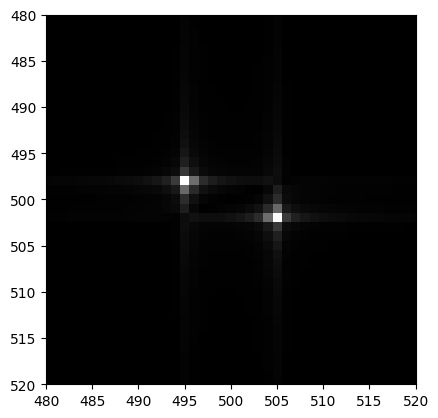

In [ ]:
# Calculate Fourier transform of grating
ft = np.fft.ifftshift(grating)
ft = np.fft.fft2(ft)
ft = np.fft.fftshift(ft)
plt.imshow(abs(ft))
plt.xlim([480, 520])
plt.ylim([520, 480])
plt.show()

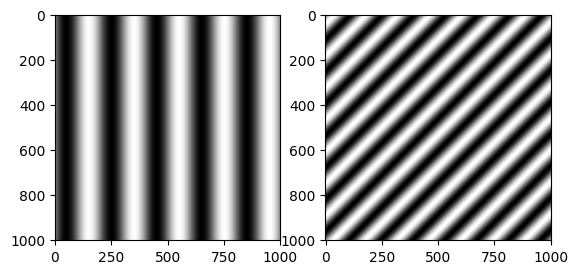

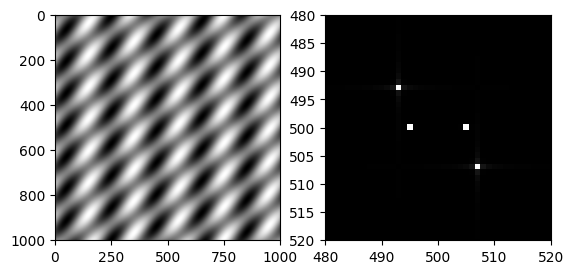

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
x = np.arange(-500, 501, 1)
X, Y = np.meshgrid(x, x)
wavelength_1 = 200
angle_1 = 0
grating_1 = np.sin(
    2*np.pi*(X*np.cos(angle_1) + Y*np.sin(angle_1)) / wavelength_1
)
wavelength_2 = 100
angle_2 = np.pi/4
grating_2 = np.sin(
    2*np.pi*(X*np.cos(angle_2) + Y*np.sin(angle_2)) / wavelength_2
)
plt.set_cmap("gray")
plt.subplot(121)
plt.imshow(grating_1)
plt.subplot(122)
plt.imshow(grating_2)
plt.show()
gratings = grating_1 + grating_2

# Calculate Fourier transform of the sum of the two gratings
ft = np.fft.ifftshift(gratings)
ft = np.fft.fft2(ft)
ft = np.fft.fftshift(ft)
plt.figure()
plt.subplot(121)
plt.imshow(gratings)
plt.subplot(122)
plt.imshow(abs(ft))
plt.xlim([480, 520])
plt.ylim([520, 480])  # Note, order is reversed for y
plt.show()

### 15.3. 2D Fourier Transform of an image

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread('Images/lenna.png')
assert img is not None, "file could not be read, check with os.path.exists()"

img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

In [ ]:
f = np.fft.fft2(img_gray, axes=(0,1))
fshift = np.fft.fftshift(f)

# generate spectrum from magnitude image (for viewing only)
magnitude_spectrum = 20*np.log(np.abs(fshift))

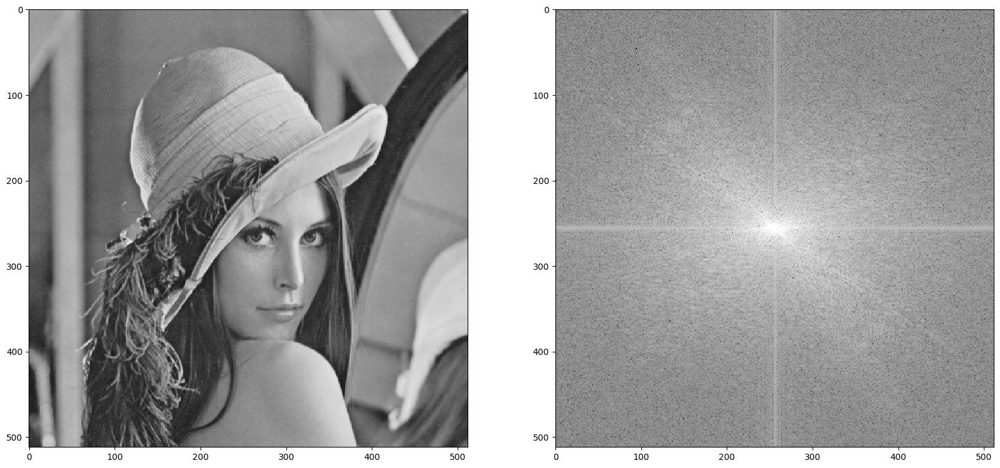

In [ ]:
# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(magnitude_spectrum, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

### 15.4. Manipulating frequencies: Filtering in frequency domain

#### Simple Circle Mask

In [ ]:
# create circle mask
radius = 32
mask = np.zeros_like(img_gray)
cy = mask.shape[0] // 2
cx = mask.shape[1] // 2
cv2.circle(mask, (cx,cy), radius, (255,255,255), -1)[0]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

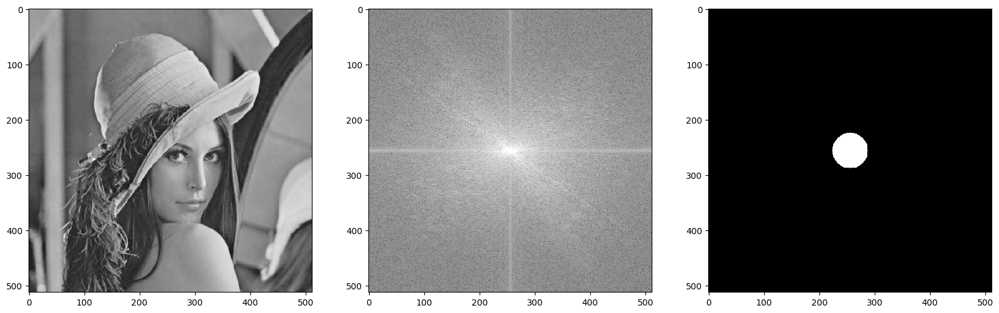

In [ ]:
# display the images
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
ax1.imshow(img_gray, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax2.imshow(magnitude_spectrum, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
ax3.imshow(mask, cmap='gray', vmin = 0, vmax = 255,interpolation='none')
plt.show()

In [ ]:
# apply mask to fshift
dft_shift_masked = np.multiply(fshift,mask) / 255

/tmp/ipython-input-14692760.py:2: RuntimeWarning: divide by zero encountered in log
  magnitude_spectrum_dft_shift_masked = 20*np.log(np.abs(dft_shift_masked))


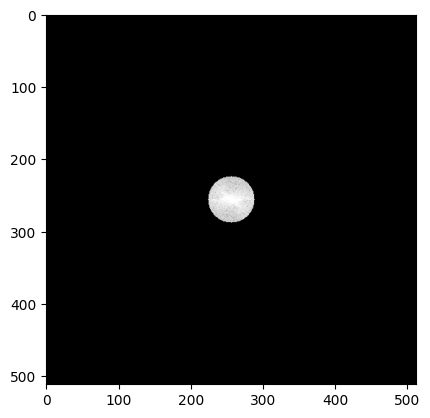

In [ ]:
# generate spectrum from magnitude image (for viewing only)
magnitude_spectrum_dft_shift_masked = 20*np.log(np.abs(dft_shift_masked))

plt.set_cmap("gray")
plt.imshow(magnitude_spectrum_dft_shift_masked.clip(0,255))
plt.show()

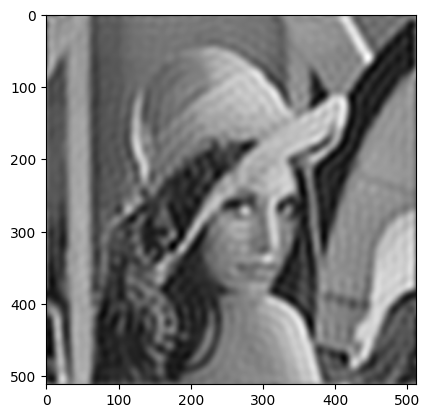

In [ ]:
back_ishift_masked = np.fft.ifftshift(dft_shift_masked)
img_filtered = np.fft.ifft2(back_ishift_masked, axes=(0,1))
img_filtered = np.abs(img_filtered).clip(0,255).astype(np.uint8)

plt.set_cmap("gray")
plt.imshow(img_filtered)
plt.show()

#### Gaussian Mask

In [ ]:
# blur the mask
mask2 = cv2.GaussianBlur(mask, (19,19), 0)

In [ ]:
# apply mask to fshift
dft_shift_masked2 = np.multiply(fshift,mask2) / 255

/tmp/ipython-input-1333631435.py:2: RuntimeWarning: divide by zero encountered in log
  magnitude_spectrum_dft_shift_masked2 = 20*np.log(np.abs(dft_shift_masked2))


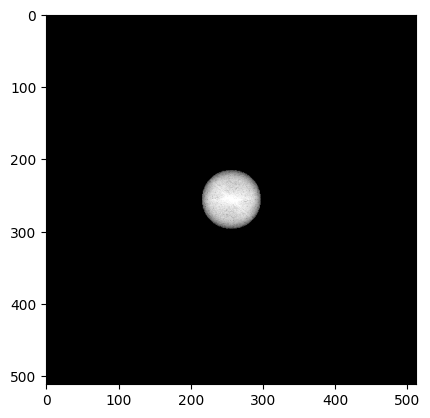

In [ ]:
# generate spectrum from magnitude image (for viewing only)
magnitude_spectrum_dft_shift_masked2 = 20*np.log(np.abs(dft_shift_masked2))

plt.set_cmap("gray")
plt.imshow(magnitude_spectrum_dft_shift_masked2.clip(0,255))
plt.show()

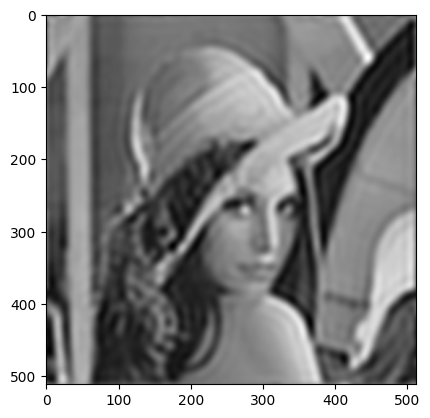

In [ ]:
back_ishift_masked2 = np.fft.ifftshift(dft_shift_masked2)

img_filtered2 = np.fft.ifft2(back_ishift_masked2, axes=(0,1))
img_filtered2 = np.abs(img_filtered2).clip(0,255).astype(np.uint8)

plt.set_cmap("gray")
plt.imshow(img_filtered2)
plt.show()

### Bonus Assignment #6: Perform High Pass filter



In [ ]:
# Task 1: Perform High pass filter, Band pass filter, and Band elimination filter in frequency domain:
# Hint1: Create a new mask that can remove the target frequency.
# Hint2: High pass filter is the inverse of low pass filter

### Bonus Assignment #7: Try this tutorial with color images (Perform LPF, HPF, BPF, BEF).

In [ ]:
# Task 2: Try this tutorial with color images (Perform LPF, HPF, BPF, BEF).
# Try at least 3 images to compare the characteristics of frequencies
# Also, test these filtering methods in different frequency range too.

## 16. Sampling

In [119]:
import cv2
import numpy as np
import sys
import os
from matplotlib import pyplot as plt

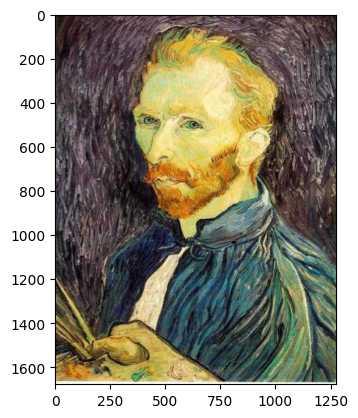

In [123]:
img = cv2.imread('Images/vg.png')
assert img is not None, "file could not be read, check with os.path.exists()"

plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.show()

### 16.1. Naive downsampling
Try to downsampling these images by just removing every 2nd row and column

In [124]:
# Remove every 2nd row and column
# We use ::2 to skip every other row and column
resized_img1 = img[::2, ::2]
resized_img2 = resized_img1[::2, ::2]
resized_img3 = resized_img2[::2, ::2]
resized_img4 = resized_img3[::2, ::2]
resized_img5 = resized_img4[::2, ::2]
resized_img6 = resized_img5[::2, ::2]

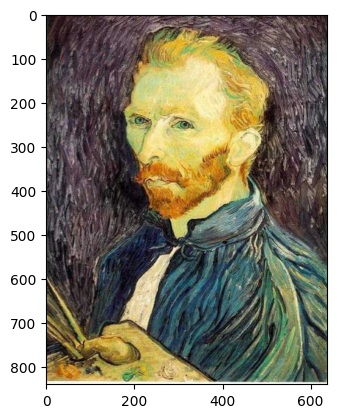

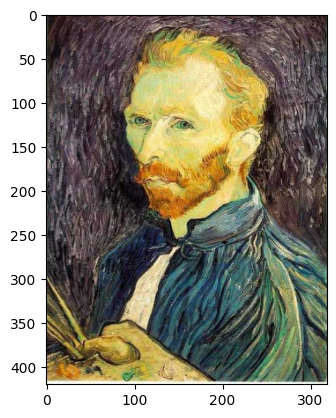

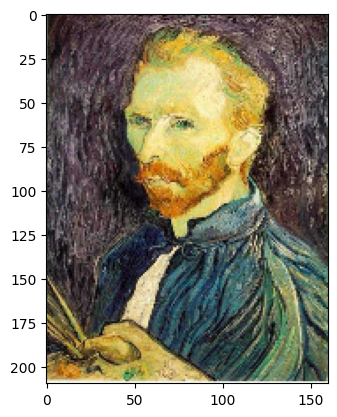

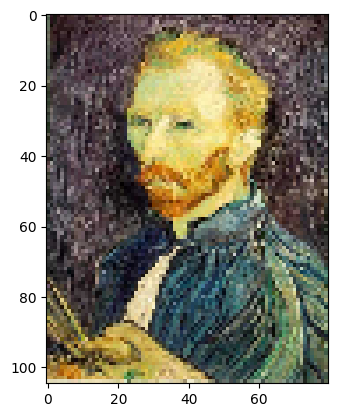

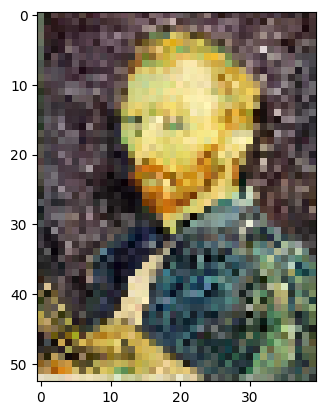

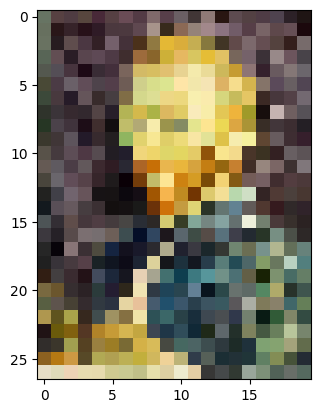

In [125]:
plt.imshow(cv2.cvtColor(resized_img1, cv2.COLOR_BGR2RGB))
plt.show()
plt.imshow(cv2.cvtColor(resized_img2, cv2.COLOR_BGR2RGB))
plt.show()
plt.imshow(cv2.cvtColor(resized_img3, cv2.COLOR_BGR2RGB))
plt.show()
plt.imshow(cv2.cvtColor(resized_img4, cv2.COLOR_BGR2RGB))
plt.show()
plt.imshow(cv2.cvtColor(resized_img5, cv2.COLOR_BGR2RGB))
plt.show()
plt.imshow(cv2.cvtColor(resized_img6, cv2.COLOR_BGR2RGB))
plt.show()

In [128]:
# The above matplotlib may not be clear. Better to see on the image on your own!
!mkdir -p Results
cv2.imwrite('Results/vg.png',img)
cv2.imwrite('Results/vg_resized_img1.png',resized_img1)
cv2.imwrite('Results/vg_resized_img2.png',resized_img2)
cv2.imwrite('Results/vg_resized_img3.png',resized_img3)
cv2.imwrite('Results/vg_resized_img4.png',resized_img4)
cv2.imwrite('Results/vg_resized_img5.png',resized_img5)
cv2.imwrite('Results/vg_resized_img6.png',resized_img6)

True

Check your downsampling images in "Results" folder !

### 16.2.Smoothing and Downsampling

In [130]:
img = cv2.imread('Images/vg.png')
assert img is not None, "file could not be read, check with os.path.exists()"

To perform smoothing and downsampling in this case, we will use the process implemented in image pyramid using gaussian blur.

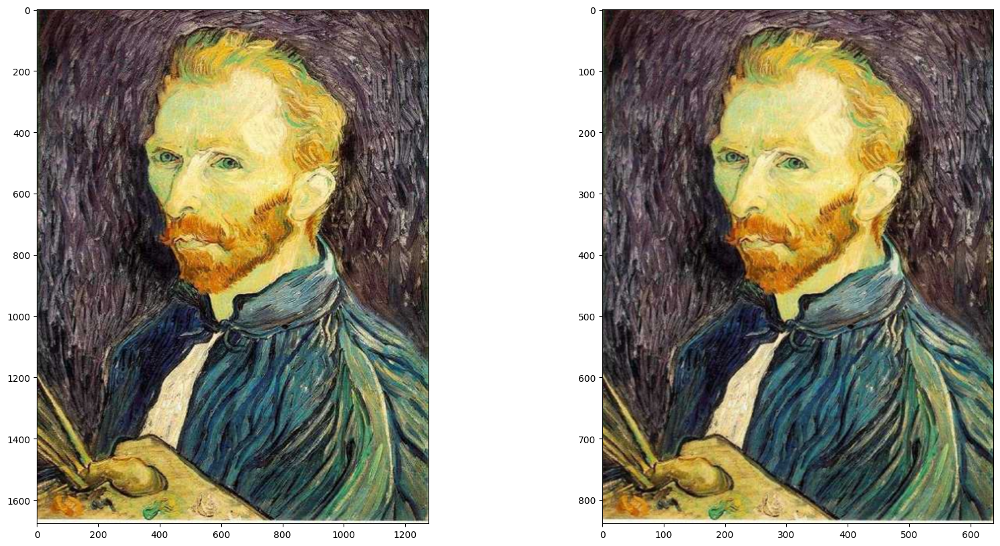

In [146]:
# Test pryDown()
lower_reso = cv2.pyrDown(img)

# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax2.imshow(cv2.cvtColor(lower_reso, cv2.COLOR_BGR2RGB))
plt.show()

In [134]:
# generate Gaussian pyramid for A
G = img.copy()
gp = [G]
for i in range(6):
    G = cv2.pyrDown(G)
    gp.append(G)

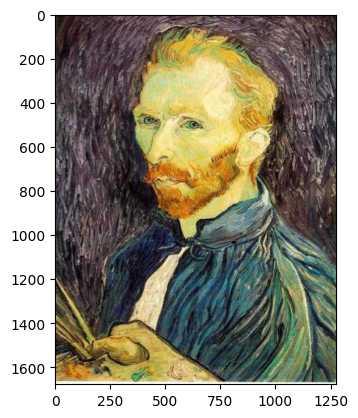

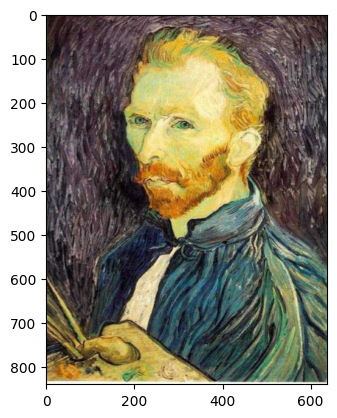

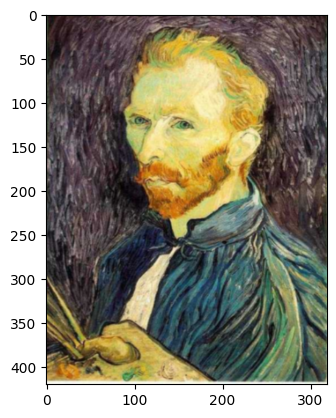

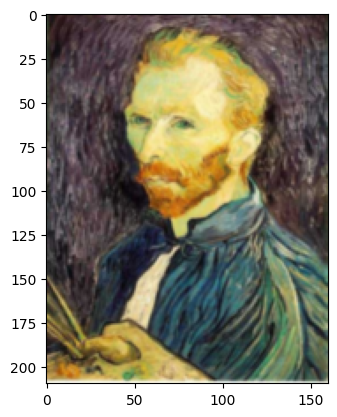

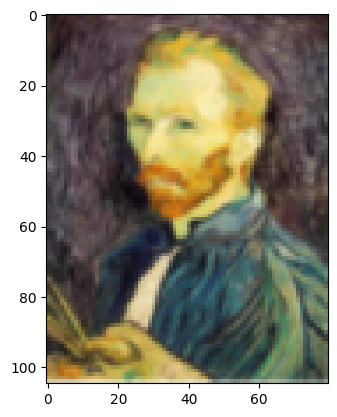

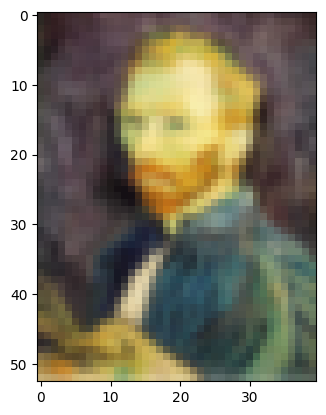

In [135]:
for i in range(6):
    G = gp[i]
    plt.imshow(cv2.cvtColor(G, cv2.COLOR_BGR2RGB))
    plt.show()
    cv2.imwrite('Results/vg_py_resized_img'+str(i)+'.png', G)